In [1]:
import anndata as ad
import scanpy as sc
import squidpy as sq
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm

from scipy.stats import pearsonr
from scipy.stats import spearmanr
from scipy.stats import stats

import seaborn as sns
import matplotlib.colors as mcolors
from scipy.stats import f_oneway

from pysal.lib import weights

from bin import utils

In [2]:
fdata_bin20 = sc.read_h5ad("./RNA/Multitime.annotation.sort.h5")
cdata_bin20 = sc.read_h5ad("./RNA/Multitime.annotation.guide.h5")

fdata = sc.read_h5ad("./RNA/Multitime.clustered.h5")
cdata = sc.read_h5ad("./RNA/Multitime.guide.h5")

In [3]:
fdata, cdata = utils.align_rna_guide_data(fdata, cdata)

In [4]:
sgs = cdata.var_names.str.split('_', n=1).str[0]
sgs_grouped = pd.DataFrame(cdata.X.toarray(), columns=cdata.var_names)
sgs_grouped = sgs_grouped.groupby(sgs, axis=1).sum()
sgdata = ad.AnnData(sgs_grouped, obs=cdata.obs, var=pd.DataFrame(index=sgs_grouped.columns))
sgdata.obsm['spatial'] = cdata.obsm['spatial']
cdata = sgdata.copy()

/tmp/ipykernel_76974/1049114494.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sgs_grouped = sgs_grouped.groupby(sgs, axis=1).sum()


In [5]:
sgs = cdata_bin20.var_names.str.split('_', n=1).str[0]
sgs_grouped = pd.DataFrame(cdata_bin20.X.toarray(), columns=cdata_bin20.var_names)
sgs_grouped = sgs_grouped.groupby(sgs, axis=1).sum()
sgdata = ad.AnnData(sgs_grouped, obs=cdata_bin20.obs, var=pd.DataFrame(index=sgs_grouped.columns))
sgdata.obsm['spatial'] = cdata_bin20.obsm['spatial']
cdata_bin20 = sgdata.copy()

/tmp/ipykernel_76974/2956383191.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sgs_grouped = sgs_grouped.groupby(sgs, axis=1).sum()


In [6]:
fdata_bin20.obs["spatial_cov"] = ['_'.join(map(str, [array[0] // 100 * 100, array[1] // 100 * 100])) for array in fdata_bin20.obsm["spatial"]]
cdata_bin20.obs["spatial_cov"] = ['_'.join(map(str, [array[0] // 100 * 100, array[1] // 100 * 100])) for array in cdata_bin20.obsm["spatial"]]

cdata.obs["spatial_cov"] = ['_'.join(map(str, [array[0] // 100 * 100, array[1] // 100 * 100])) for array in cdata.obsm["spatial"]]
fdata.obs["spatial_cov"] = ['_'.join(map(str, [array[0] // 100 * 100, array[1] // 100 * 100])) for array in fdata.obsm["spatial"]]

In [15]:
fdata.var_names[fdata.var_names.str.startswith("Col3")]

Index(['Col3a1'], dtype='object')

In [7]:
sc.tl.score_genes(fdata, gene_list=["Col1a1", "Col1a2"], score_name="collegen_score")

In [36]:
plt.subplots(3, 2)

array([[<Axes: >, <Axes: >],
       [<Axes: >, <Axes: >],
       [<Axes: >, <Axes: >]], dtype=object)

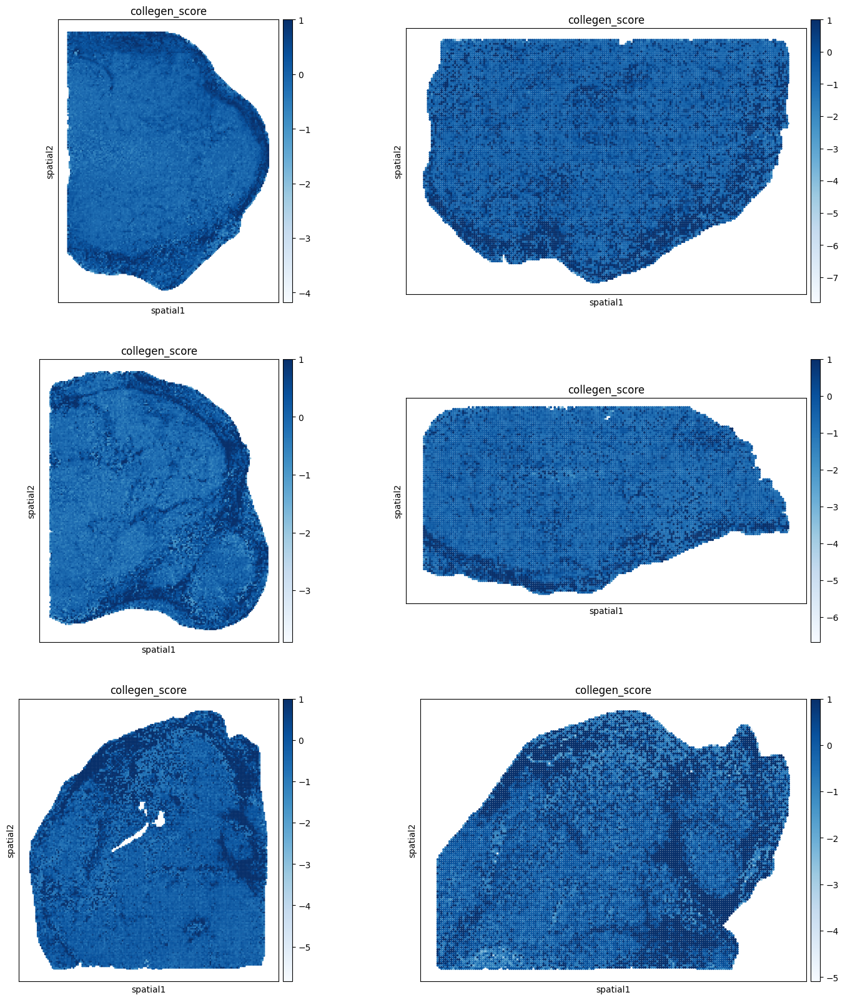

In [9]:
fig, axs = plt.subplots(3, 2, figsize=(20, 20))
for idx, marker in enumerate(np.unique(fdata.obs.marker)):
    ax = axs[idx // 2, idx % 2]
    sq.pl.spatial_scatter(fdata[fdata.obs["marker"] == marker], color="collegen_score", size=5 + (idx % 2) * 5, shape=None, library_id="spatial", cmap="Blues", vmax=1, ax=ax)

In [73]:
bin100_with_exhausted = utils.extract_big_bin(fdata, fdata_bin20[fdata_bin20.obs["annotations"] == "exhausted T"])

/home/wpy/stereoseq/20240502-SPACseq/bin/utils.py:327: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  bin20_masked_data.obs["spatial_cov"] = ['_'.join(map(str, [array[0] // bin_size * bin_size, array[1] // bin_size * bin_size])) for array in bin20_masked_data.obsm["spatial"]]


In [11]:
bin100_with_exhausted

AnnData object with n_obs × n_vars = 36384 × 13177
    obs: 'marker', 'n_genes', 'n_counts', '_scvi_batch', '_scvi_labels', 'cluster_cellcharter_givenk', 'cov', 'spatial_cov', 'collegen_score'
    var: 'mt', 'mt-', 'gm', 'Rb', 'rik'
    uns: '_cellcharter', '_scvi_manager_uuid', '_scvi_uuid', 'cluster_cellcharter_givenk_colors', 'log1p', 'rank_genes_groups', 'spatial_neighbors'
    obsm: 'X_cellcharter', 'X_scVI', 'spatial'
    layers: 'counts'
    obsp: 'spatial_connectivities', 'spatial_distances'

In [13]:
bin100_with_exhausted

AnnData object with n_obs × n_vars = 36384 × 13177
    obs: 'marker', 'n_genes', 'n_counts', '_scvi_batch', '_scvi_labels', 'cluster_cellcharter_givenk', 'cov', 'spatial_cov', 'collegen_score'
    var: 'mt', 'mt-', 'gm', 'Rb', 'rik'
    uns: '_cellcharter', '_scvi_manager_uuid', '_scvi_uuid', 'cluster_cellcharter_givenk_colors', 'log1p', 'rank_genes_groups', 'spatial_neighbors'
    obsm: 'X_cellcharter', 'X_scVI', 'spatial'
    layers: 'counts'
    obsp: 'spatial_connectivities', 'spatial_distances'

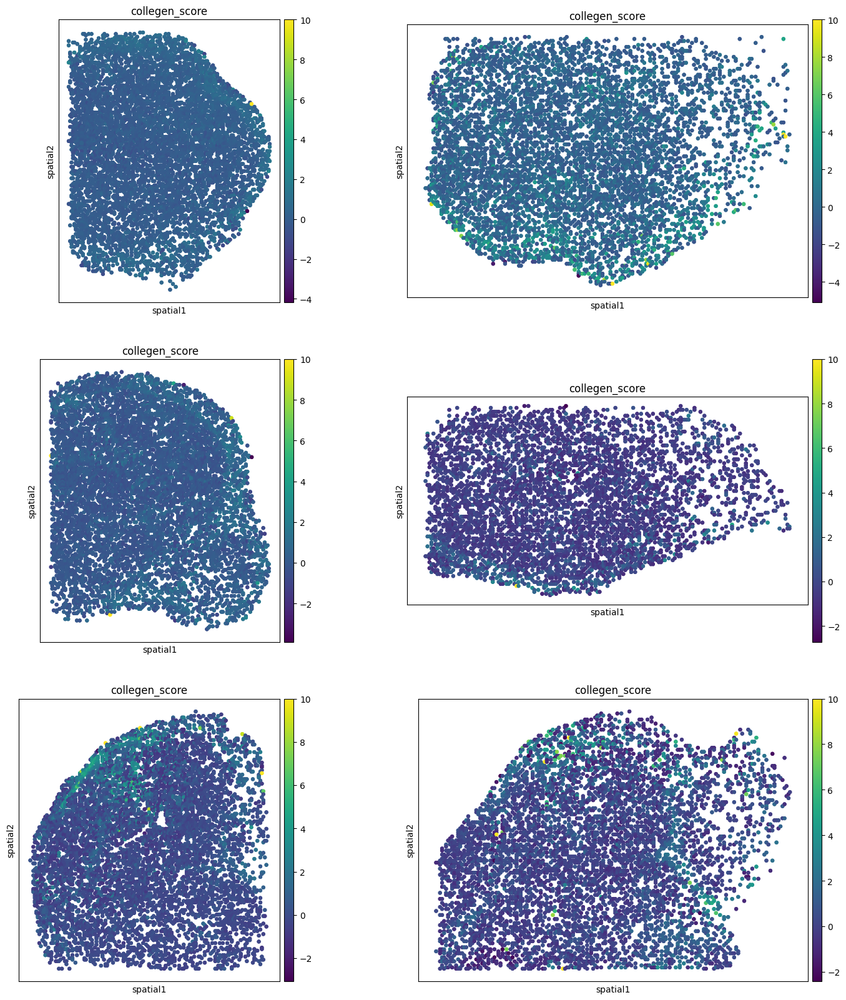

In [20]:
#sq.pl.spatial_scatter(bin100_with_exhausted, color="collegen_score", shape=None, size=2, library_key="marker")
fig, axs = plt.subplots(3, 2, figsize=(20, 20))
for idx, marker in enumerate(np.unique(fdata.obs.marker)):
    ax = axs[idx // 2, idx % 2]
    sq.pl.spatial_scatter(bin100_with_exhausted[bin100_with_exhausted.obs["marker"] == marker], color="collegen_score", size=50, shape=None, vmax=10,  library_id="spatial", ax=ax)

In [185]:
bin100_high_col = fdata[fdata.obs["collegen_score"] > 1]
bin20_high_col = utils.extract_small_bin(fdata_bin20, bin100_high_col)
bin20_with_t = bin20_high_col[bin20_high_col.obs["annotations"].str.endswith("T")].copy()
bin20_with_t

AnnData object with n_obs × n_vars = 83110 × 13177
    obs: 'marker', 'annotations', 'cov', 'cluster', 'spatial_cov'
    var: 'mt', 'mt-', 'gm', 'Rb', 'rik'
    uns: 'rank_genes_groups'
    obsm: 'spatial'

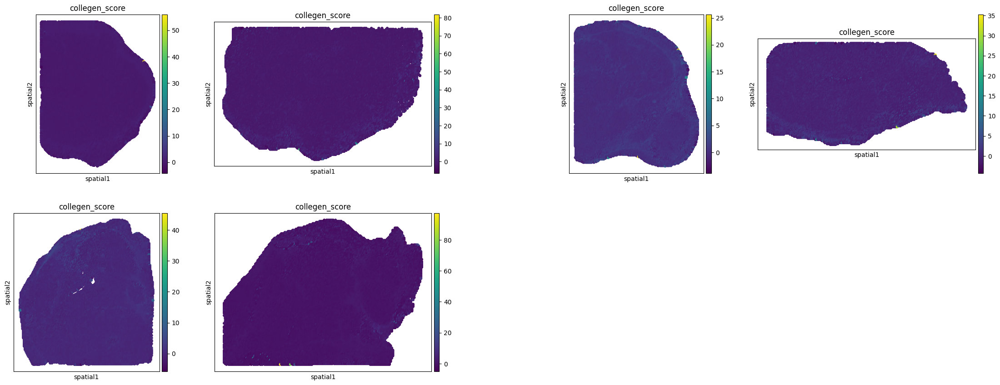

In [25]:
sq.pl.spatial_scatter(bin100_with_t, color="collegen_score", shape=None, size=50, library_key="marker")

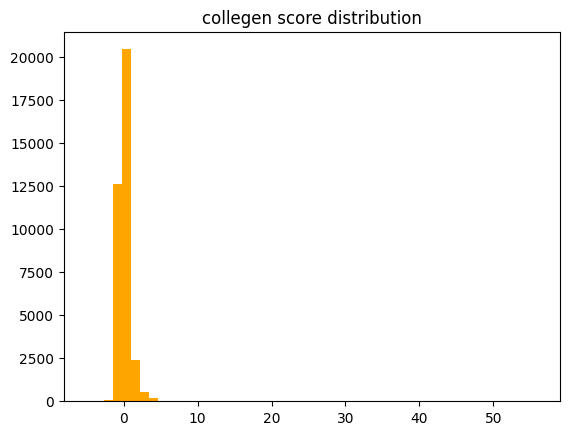

In [26]:
plt.hist(bin100_with_exhausted.obs["collegen_score"], bins=50, color="Orange")
plt.title("collegen score distribution")
plt.show()

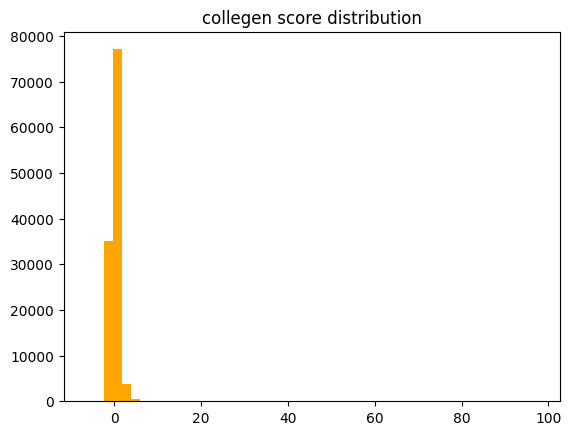

In [27]:
plt.hist(bin100_with_t.obs["collegen_score"], bins=50, color="Orange")
plt.title("collegen score distribution")
plt.show()

In [72]:
bin100_with_exhausted[bin100_with_exhausted.obs["collegen_score"] > 0]

View of AnnData object with n_obs × n_vars = 16717 × 13177
    obs: 'marker', 'n_genes', 'n_counts', '_scvi_batch', '_scvi_labels', 'cluster_cellcharter_givenk', 'cov', 'spatial_cov', 'collegen_score'
    var: 'mt', 'mt-', 'gm', 'Rb', 'rik'
    uns: '_cellcharter', '_scvi_manager_uuid', '_scvi_uuid', 'cluster_cellcharter_givenk_colors', 'log1p', 'rank_genes_groups', 'spatial_neighbors'
    obsm: 'X_cellcharter', 'X_scVI', 'spatial'
    layers: 'counts'
    obsp: 'spatial_connectivities', 'spatial_distances'

In [30]:
bin20_with_exhausted = utils.extract_small_bin(fdata_bin20, bin100_with_exhausted[bin100_with_exhausted.obs["collegen_score"] > 0])

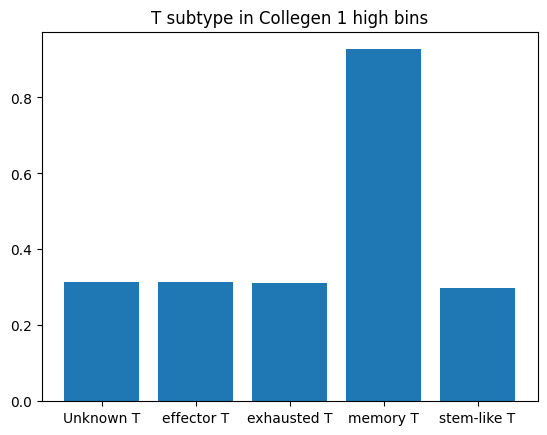

In [88]:
c_df = bin20_with_exhausted[bin20_with_exhausted.obs["annotations"].str.endswith("T")].obs["annotations"].value_counts()
t_counts = fdata_bin20[fdata_bin20.obs["annotations"].str.endswith("T")].obs["annotations"].value_counts()
plt.bar(height=c_df / t_counts, x=c_df.index)
plt.title("T subtype in Collegen 1 high bins")
plt.show()

In [33]:
bin20_with_t[bin20_with_t.obs["annotations"].str.endswith("T")].obs["annotations"].value_counts()

annotations
Unknown T      19703
effector T      5627
memory T        2166
exhausted T     1184
stem-like T      691
Name: count, dtype: int64

4
4
4
4
4


/tmp/ipykernel_36355/186108519.py:12: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(p_df.index, rotation=90)
/tmp/ipykernel_36355/186108519.py:12: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(p_df.index, rotation=90)
/tmp/ipykernel_36355/186108519.py:12: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(p_df.index, rotation=90)
/tmp/ipykernel_36355/186108519.py:12: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(p_df.index, rotation=90)
/tmp/ipykernel_36355/186108519.py:12: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a 

4


/tmp/ipykernel_36355/186108519.py:12: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(p_df.index, rotation=90)


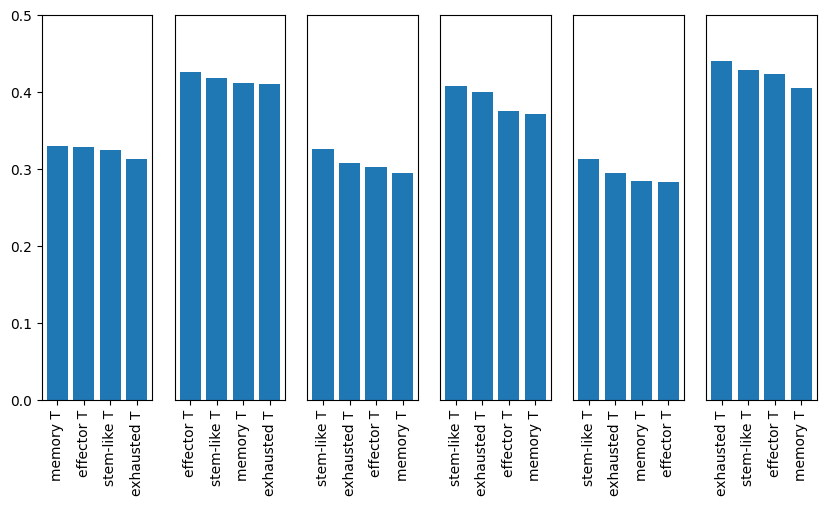

In [190]:
fig, axs = plt.subplots(1, 6, figsize=(10, 5))
for idx, marker in enumerate(np.unique(bin20_with_exhausted.obs["marker"])):
    ax=axs[idx]
    c_df = bin20_with_t[(bin20_with_t.obs["marker"] == marker)].obs["annotations"].value_counts()
    t_counts = fdata_bin20[fdata_bin20.obs["annotations"].str.endswith("T") & (fdata_bin20.obs["marker"] == marker)].obs["annotations"].value_counts()
    p_df = (c_df / t_counts)
    p_df = p_df[p_df.index != "Unknown T"]
    p_df.sort_values(inplace=True, ascending=False)
    print(p_df.shape[0])
    ax.set_ylim(0, 0.5)
    ax.bar(height=p_df, x=p_df.index)
    ax.set_xticklabels(p_df.index, rotation=90)
    if idx > 0: ax.set_yticks([])

In [58]:
bin20_with_guide = extract_bin20(cdata_bin20, bin100_with_exhausted[bin100_with_exhausted.obs["collegen_score"] > 0])

In [71]:
T_marker = {
    "naive T": ["Ccr7", "Tcf7", "Lef1", "Sell", "Klf2"],
    "memory T": ["Il7r", "Cd27", "Timp1"],
    "Tcm": ["Ccr7", "Sell"],
    "Tem": ["Eomes", "Gzmk"],
    "Trm": ["Cd69", "Itgae", "Xcl1", "Zfp683", "Klf2", "S1pr1"],
    "Temra": ["Tbx21", "Gzmb", "Nkg7"],
    "effector T": ["Gzmk", "Gzma", "Gzmb", "Prf1", "Nkg7"],
    "exhausted T": ["Havcr2", "Lag3", "Entpd1", "Tigit", "Ctla4", "Layn"],
    "stem-like T": ["Tcf7", "Foxo1"]
}

In [70]:
bin20_with_guide.obs["guide"] = bin20_with_guide[bin20_with_guide]

AnnData object with n_obs × n_vars = 13561 × 34
    obs: 'spatial_cov'
    obsm: 'spatial'

In [83]:
sc.tl.score_genes(bin20_with_exhausted, gene_list=T_marker["exhausted T"], score_name="ex_score")

In [79]:
bin20_with_guide.obs["guide"] = bin20_with_guide.var_names[np.argmax(bin20_with_guide.X, axis=1)]
bin20_with_guide.obs["guide"][np.sum(bin20_with_guide.X, axis=1) == 0] = "None"

/tmp/ipykernel_7609/2980128793.py:2: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  bin20_with_guide.obs["guide"][np.sum(bin20_with_guide.X, axis=1) == 0] = "None"


In [173]:
bin20_with_guide[bin20_with_exhausted.obs["annotations"] == "exhausted T"].obs["guide"].value_counts().sort_index()[1:]

guide
sgCxcl16     1
sgDdit3      4
sgFbxo7      1
sgFlot1      4
sgGata3      2
sgMark3      1
sgMcoln1     1
sgPpia       1
sgScamp4     4
sgSlc39a8    1
sgSrgn       1
sgTmem64     2
sgZc3h12a    6
sgZhx2       1
sgZscan12    1
Name: count, dtype: int64

[]

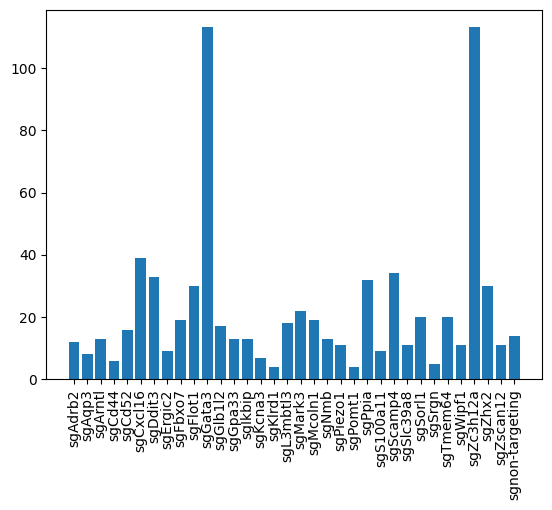

In [174]:
plt.bar(height=bin20_with_guide.obs["guide"].value_counts().sort_index()[1:], x=bin20_with_guide.var_names.tolist())
plt.xticks(rotation=90)
plt.plot()

In [169]:
p_df

,guide,ex_score
427470,None,-0.079904
615002,None,-0.137925
407329,None,-0.032409
308267,None,-0.039124
428365,None,-0.025559
...,...,...
517621,None,0.000000
515829,None,0.000000
18476,None,0.000000
463747,None,0.000000


In [86]:
p_df = pd.concat([bin20_with_guide.obs["guide"], bin20_with_exhausted.obs["ex_score"]], axis=1)

In [108]:
p_dict = p_df[p_df["guide"] != "None"].groupby("guide")["ex_score"].apply(list).to_dict()

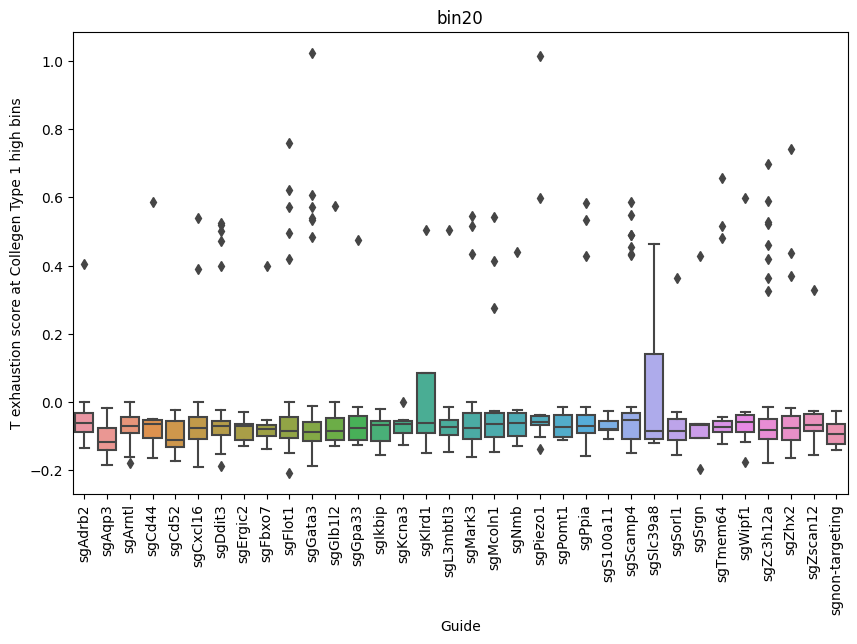

In [168]:
long_format_data = pd.DataFrame([(k, v) for k, lst in p_dict.items() for v in lst], columns=['guide', 'value'])
#long_format_data = long_format_data[np.isin(long_format_data["guide"], ["sgGata3", "sgCd44", "sgnon-targeting"])]

non_targeting_data = long_format_data[long_format_data['guide'] == 'sgnon-targeting']['value']
anova_results = {}
for key in p_dict:
    if key != 'sgnon-targeting' and key in ["sgGata3", "sgCd44", "sgnon-targeting"]:
        group_data = long_format_data[long_format_data['guide'] == key]['value']
        f_val, p_val = f_oneway(non_targeting_data, group_data)
        anova_results[key] = p_val

plt.figure(figsize=(10, 6))
ax = sns.boxplot(x='guide', y='value', data=long_format_data)

plt.xlabel('Guide')
plt.ylabel('T exhaustion score at Collegen Type 1 high bins')
plt.title('bin20')
plt.xticks(rotation=90)

plt.show()

[]

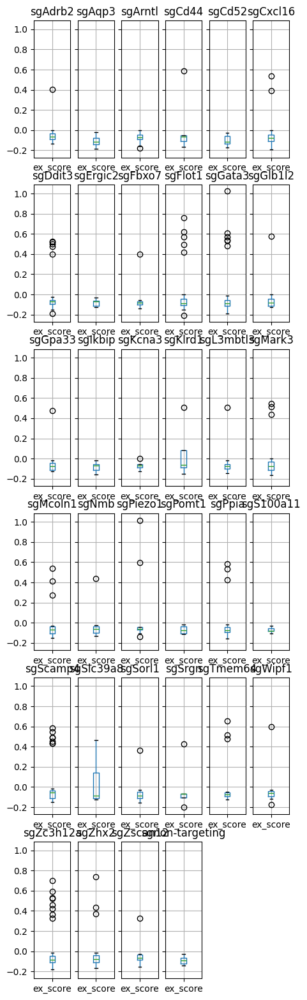

In [93]:
p_df[p_df["guide"] != "None"].groupby("guide").boxplot(figsize=(5, 20))
plt.plot()

In [120]:
t_df = pd.concat([bin20_with_guide.obs["guide"], bin20_with_exhausted.obs["annotations"]], axis=1)

In [125]:
count_df = t_df[t_df.annotations.str.endswith("T") & (t_df.guide != "None")].value_counts()

In [142]:
t_types = np.unique(t_df.annotations[t_df.annotations.str.endswith("T")])

In [150]:
count_df["sgGata3"]

annotations
Unknown T      5
effector T     3
exhausted T    2
Name: count, dtype: int64

In [151]:
count_df["sgnon-targeting"]

annotations
effector T    1
Name: count, dtype: int64

In [156]:
print(pd.DataFrame(count_df).T)

guide         sgZc3h12a   sgGata3    sgFlot1                 sgDdit3  \
annotations exhausted T Unknown T effector T exhausted T exhausted T   
count                 6         5          4           4           4   

guide          sgScamp4    sgGata3  sgScamp4    sgDdit3  sgCxcl16  ...  \
annotations exhausted T effector T Unknown T effector T Unknown T  ...   
count                 4          3         3          3         2  ...   

guide          sgSorl1   sgSlc39a8  sgWipf1 sgTmem64      sgSrgn   sgZc3h12a  \
annotations effector T exhausted T memory T memory T exhausted T stem-like T   
count                1           1        1        1           1           1   

guide                      sgZhx2   sgZscan12 sgnon-targeting  
annotations Unknown T exhausted T exhausted T      effector T  
count               1           1           1               1  

[1 rows x 44 columns]


In [131]:
count_df = pd.DataFrame(np.array([count_df[:, t_type].tolist() for t_type in t_types]), columns=cdata.var_names, index=t_types).T
count_df

KeyError: False

# Bounderies

In [43]:
def plot_contour(adata, score_name, ax, cmap="viridis", levels=8):

    apo_bin = adata.obs[score_name]
    hypo_coord = adata.obsm['spatial']
    coord_df = pd.DataFrame({
        'x_coord': hypo_coord[:, 0],
        'y_coord': hypo_coord[:, 1],
        'value': apo_bin
    })
    coord_df_piv = pd.pivot_table(coord_df, values="value", index="y_coord", columns="x_coord", aggfunc=np.mean)
    z = coord_df_piv.values
    y = coord_df_piv.index
    x = coord_df_piv.columns
    color_map = plt.get_cmap(cmap)

    new_cmap = mcolors.ListedColormap(color_map(np.linspace(0, 1, 100)))
    new_cmap.colors[:, -1] = np.linspace(0, 0.8, new_cmap.N)

    cs = ax.contourf(x, y, z, levels=levels, cmap=new_cmap)
    plt.colorbar(cs, ax=ax, shrink=0.7)

def plot_dot(adata, gene_name, ax, color="Orange", square=True, alpha=0.2):
    x = adata.obsm["spatial"][:, 0]
    y = adata.obsm["spatial"][:, 1]
    a = adata[:, gene_name].X.toarray().flatten()
    if square is True:
        ax.scatter(x, y, s=np.square(a), alpha=alpha, color=color, label=gene_name)
    else:
        ax.scatter(x, y, s=a, alpha=alpha, color=color, lable=gene_name)

/tmp/ipykernel_36355/4240097618.py:10: FutureWarning: The provided callable <function mean at 0x7ff3fc0eb9c0> is currently using DataFrameGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  coord_df_piv = pd.pivot_table(coord_df, values="value", index="y_coord", columns="x_coord", aggfunc=np.mean)
/tmp/ipykernel_36355/4240097618.py:10: FutureWarning: The provided callable <function mean at 0x7ff3fc0eb9c0> is currently using DataFrameGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  coord_df_piv = pd.pivot_table(coord_df, values="value", index="y_coord", columns="x_coord", aggfunc=np.mean)
/tmp/ipykernel_36355/4240097618.py:10: FutureWarning: The provided callable <function mean at 0x7ff3fc0eb9c0> is currently using DataFrameGroupBy.mean. In a future version of pandas, the provided callable wil

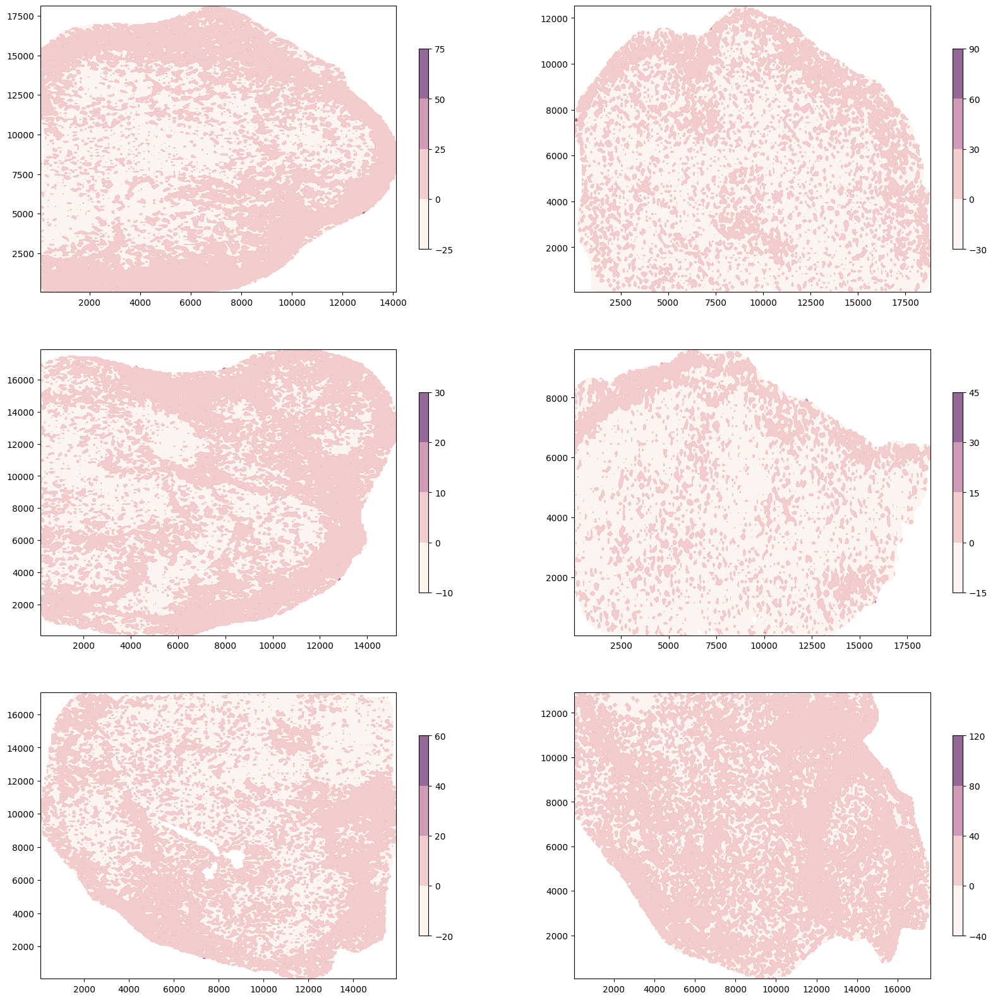

In [45]:
fig, axs = plt.subplots(3, 2, figsize=(20, 20))
for idx, marker in enumerate(np.unique(fdata.obs.marker)):
    ax = axs[idx // 2, idx % 2]
    plot_contour(fdata[fdata.obs["marker"] == marker], score_name="collegen_score", ax=ax, cmap="flare", levels=2)

/tmp/ipykernel_7609/1586555307.py:13: FutureWarning: The provided callable <function mean at 0x7fe8340df9c0> is currently using DataFrameGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  coord_df_piv = pd.pivot_table(coord_df, values="value", index="y_coord", columns="x_coord", aggfunc=np.mean)


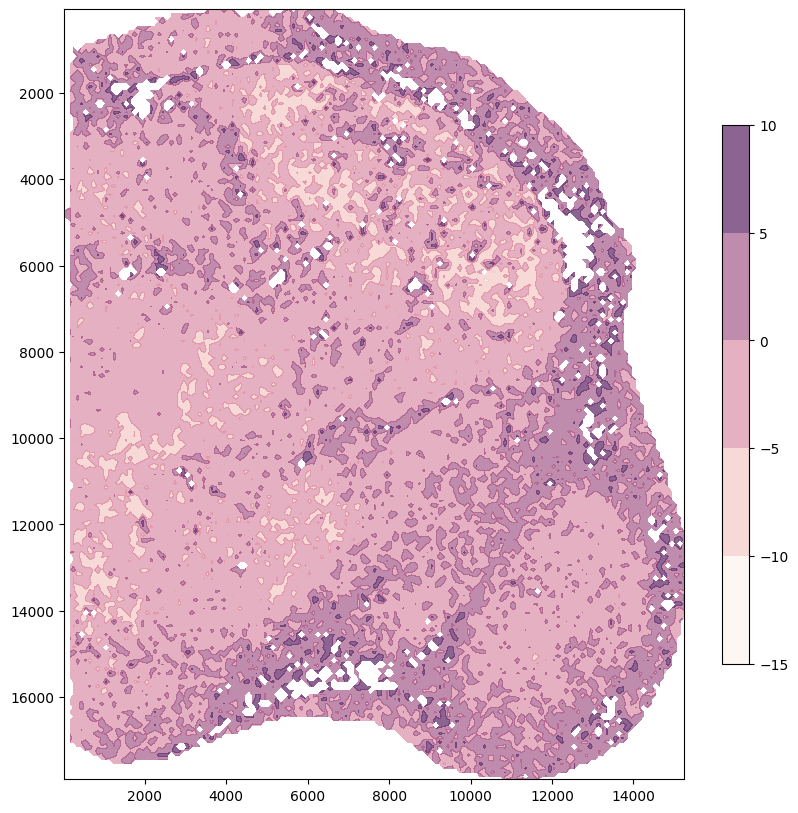

In [191]:
fig, ax=plt.subplots(1, 1, figsize=(10, 10))
plot_contour(fdata[fdata.obs["collegen_score"] < 10], score_name="collegen_score", ax=ax, cmap="flare", vmax=4)
plt.gca().invert_yaxis()

In [75]:
fdata.obs

,collegen_score,spatial_cov,collegen
10265,3.300000,"(5700, 400)",1
6487,-2.926667,"(3600, 600)",0
6848,-0.913333,"(3800, 700)",0
5049,0.813333,"(2800, 800)",1
6490,0.246667,"(3600, 900)",1
...,...,...,...
2704,0.000000,"(1500, 300)",0
3963,0.000000,"(2200, 200)",0
48,0.000000,"(0, 4700)",0
3603,0.000000,"(2000, 200)",0


In [167]:
threshold = np.mean(fdata.obs["collegen_score"])
fdata.obs["collegen"] = [1 if score > threshold else 0 for score in fdata.obs["collegen_score"]]

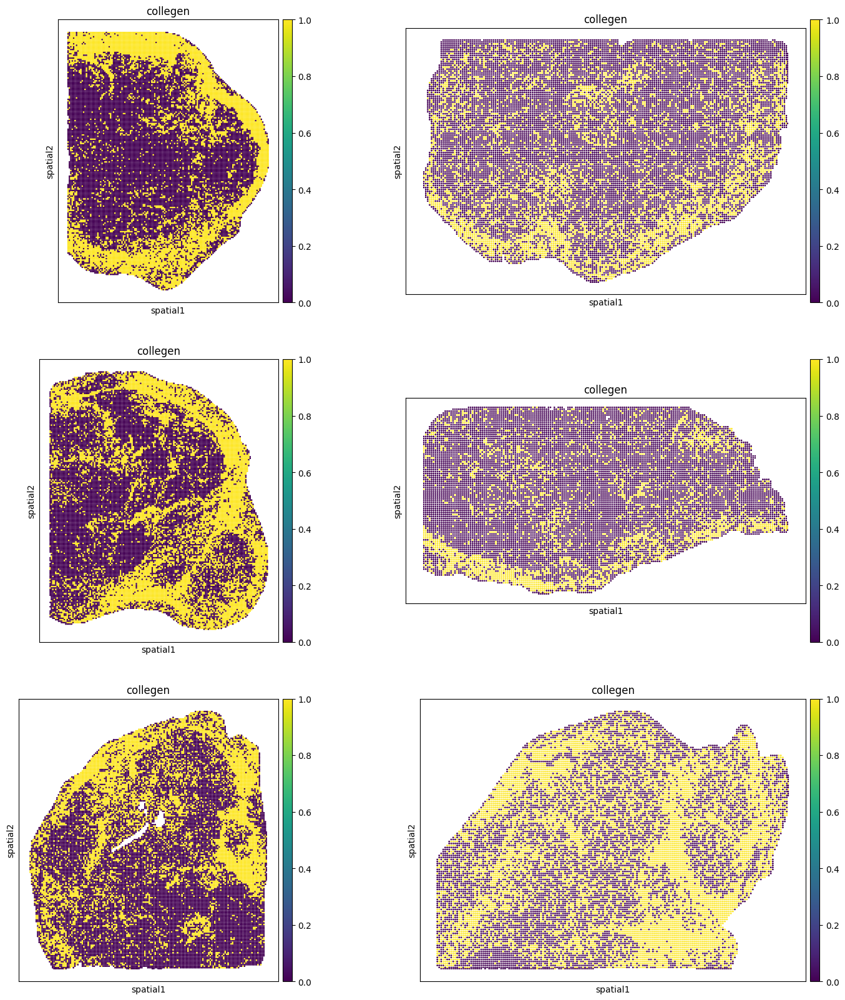

In [168]:
fig, axs = plt.subplots(3, 2, figsize=(20, 20))
utils.plot_score(fdata, field="collegen", axs=axs)

In [59]:
fdata.obs["collegen"] = fdata[:, ["Col1a1", "Col1a2"]].X.sum(axis=1) > 0

In [60]:
fdata.obs["collegen"] = (fdata[:, ["Col1a1"]].X > 0).toarray() & (fdata[:, ["Col1a2"]].X > 0).toarray()

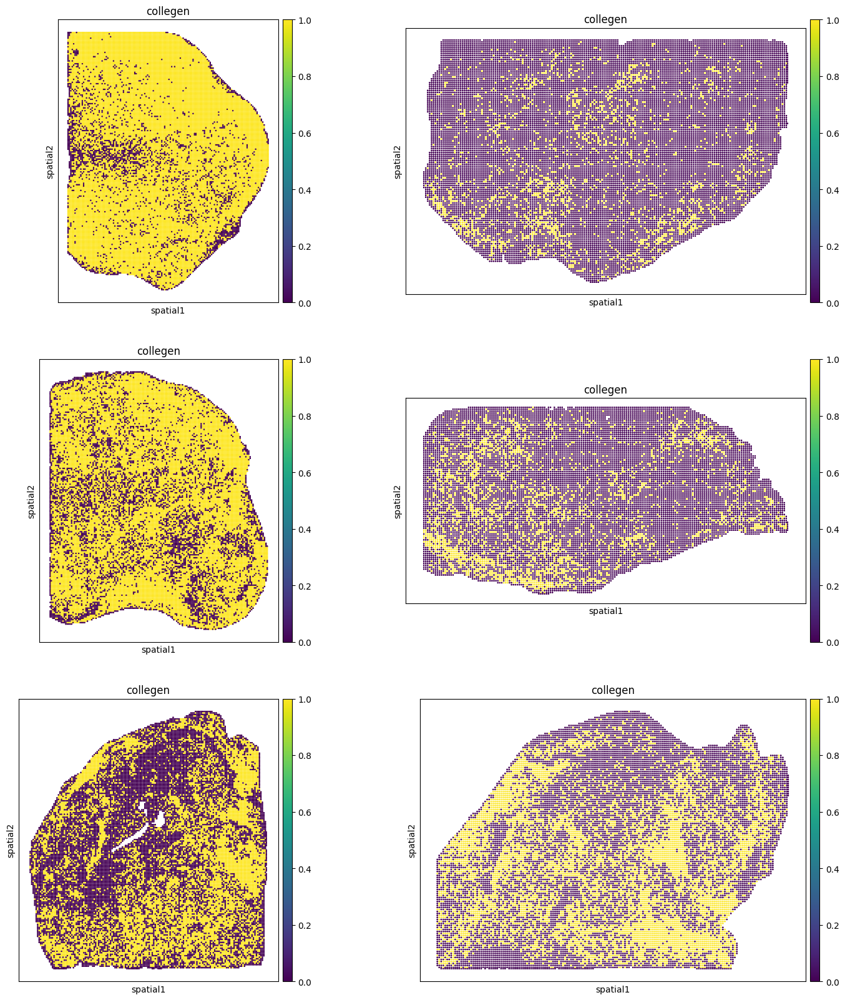

In [61]:
fig, axs = plt.subplots(3, 2, figsize=(20, 20))
utils.plot_score(fdata, field="collegen", axs=axs)

In [170]:
# Collegen 多的地方，T exhaust

In [169]:
high_data = extract_small_bin(fdata_bin20, fdata[fdata.obs["collegen"] > 0])

NameError: name 'extract_bin20' is not defined

In [209]:
low_data = extract_bin20(fdata_bin20, fdata[fdata.obs["collegen"] <= 0])

[ True  True  True ...  True  True  True]


In [217]:
high_df = high_data.obs["annotations"][high_data.obs["annotations"].str.endswith("T")].value_counts()

In [218]:
low_df = low_data.obs["annotations"][low_data.obs["annotations"].str.endswith("T")].value_counts()

In [264]:
c_df = pd.concat([high_df, low_df], axis=1)
c_df = c_df[:5].T
c_df = c_df / c_df.sum(axis=0)
c_df.index = ["high", "low"]

In [265]:
c_df

annotations,Unknown T,effector T,memory T,stem-like T,exhausted T
high,0.154227,0.132245,0.14719,0.185856,0.130102
low,0.845773,0.867755,0.85281,0.814144,0.869898


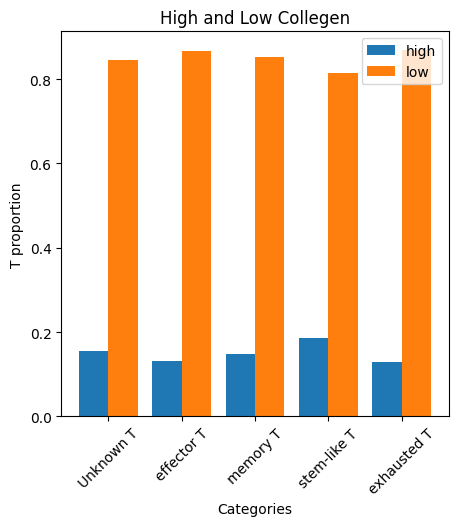

In [295]:
fig, ax = plt.subplots(1, 1, figsize=(5, 5))

bar_width = 0.4
indices = np.arange(len(c_df.columns))

ax.bar(indices - bar_width/2, c_df.loc["high"], width=bar_width, label="high")
ax.bar(indices + bar_width/2, c_df.loc["low"], width=bar_width, label="low")

ax.set_xlabel('Categories')
ax.set_ylabel('T proportion')
ax.set_title('High and Low Collegen')
ax.set_xticks(indices)
ax.set_xticklabels(c_df.columns)
plt.xticks(rotation=45)

ax.legend()
plt.show()

In [241]:
p_df = high_data.obs[["annotations", "spatial_cov"]].groupby("spatial_cov").value_counts().unstack()
p_df = p_df.loc[: ,p_df.columns.str.endswith("T")]
p_df

annotations,effector T,stem-like T,memory T,exhausted T,Unknown T
spatial_cov,,,,,
10000_13600,1,0,0,0,0
10000_17100,0,0,1,0,3
10000_1900,0,0,0,0,1
10000_2400,0,0,0,0,0
10000_2500,1,0,0,0,1
...,...,...,...,...,...
9900_2900,2,0,1,1,1
9900_3500,2,2,0,0,3
9900_5700,0,0,1,0,0


In [243]:
pl_df = low_data.obs[["annotations", "spatial_cov"]].groupby("spatial_cov").value_counts().unstack()
pl_df = pl_df.loc[: ,pl_df.columns.str.endswith("T")]
pl_df

annotations,effector T,stem-like T,memory T,exhausted T,Unknown T
spatial_cov,,,,,
0_4700,0,0,0,0,0
0_4800,0,0,0,0,0
10000_10000,1,0,0,1,3
10000_10100,0,0,0,0,1
10000_10200,0,0,0,0,1
...,...,...,...,...,...
9900_9400,2,0,0,0,1
9900_9500,0,0,0,0,0
9900_9600,0,0,0,0,2


In [245]:
f_oneway(p_df["exhausted T"], pl_df["exhausted T"])

F_onewayResult(statistic=12.556870521625552, pvalue=0.00039553158973585544)

In [305]:
exhaust_df

,exhausted T,exhausted T
spatial_cov,,
10000_13600,0.0,NaN
10000_17100,0.0,NaN
10000_1900,0.0,NaN
10000_2400,0.0,NaN
10000_2500,0.0,NaN
...,...,...
9900_9400,NaN,0.0
9900_9500,NaN,0.0
9900_9600,NaN,0.0


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


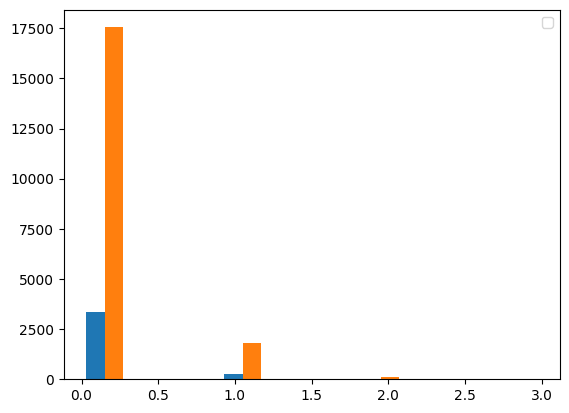

In [311]:
exhaust_df = pd.concat([p_df["exhausted T"], pl_df["exhausted T"]], axis=1)
plt.hist(exhaust_df)
plt.legend()
plt.show()

<Axes: >

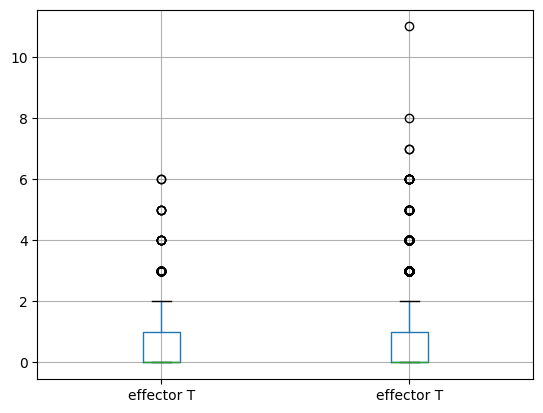

In [300]:
effector_df = pd.concat([p_df["effector T"], pl_df["effector T"]], axis=1)
effector_df.boxplot()

In [296]:
f_oneway(p_df["effector T"], pl_df["effector T"])

F_onewayResult(statistic=44.18235211383634, pvalue=3.058389594998251e-11)

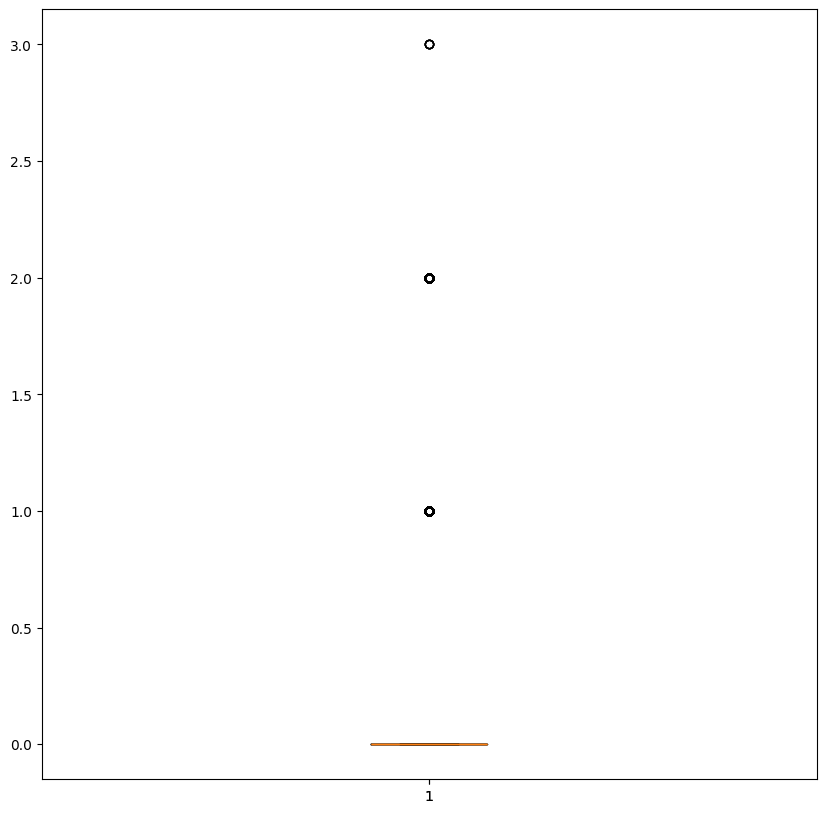

In [255]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
ax.boxplot(p_df["exhausted T"])
ax.boxplot(pl_df["exhausted T"])
plt.show()

# Guide

In [192]:
cdata.obs["collegen"] = fdata.obs["collegen"]

In [193]:
count_df = pd.DataFrame(cdata.X)
count_df.columns = cdata.var_names

count_df["collegen"] = cdata.obs["collegen"].tolist()

In [194]:
mean_df = count_df.groupby("collegen").mean().T

In [195]:
sum_df = count_df.groupby("collegen").sum().T

In [196]:
from scipy.stats import chi2_contingency

/tmp/ipykernel_36355/4144887715.py:11: FutureWarning: The provided callable <function sum at 0x7ff3fc0ea8e0> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.
  c_table = pd.pivot_table(pd.DataFrame(data), values="Sum", index="Category", columns="Group", aggfunc=np.sum)
/tmp/ipykernel_36355/4144887715.py:11: FutureWarning: The provided callable <function sum at 0x7ff3fc0ea8e0> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.
  c_table = pd.pivot_table(pd.DataFrame(data), values="Sum", index="Category", columns="Group", aggfunc=np.sum)
/tmp/ipykernel_36355/4144887715.py:11: FutureWarning: The provided callable <function sum at 0x7ff3fc0ea8e0> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be u

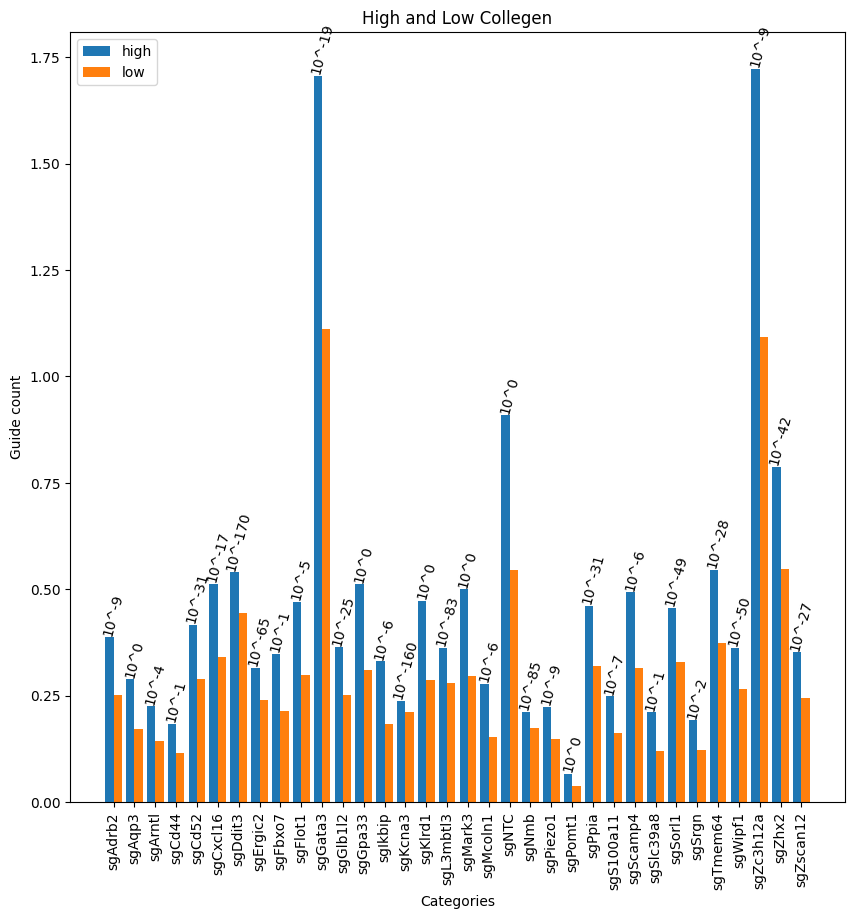

In [198]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10))

p_ = []
for guide in cdata.var_names:
    data = {
        'Group': [guide, guide, "NTC", "NTC"],
        'Category': ["high", "low", "high", "low"],
        'Sum': [sum_df.loc[guide].iloc[1], sum_df.loc[guide].iloc[0], sum_df.loc["sgNTC"].iloc[1], sum_df.loc["sgNTC"].iloc[0]]
    }
    # print(data['Sum'])
    c_table = pd.pivot_table(pd.DataFrame(data), values="Sum", index="Category", columns="Group", aggfunc=np.sum)
    chi2, p, dof, expected = chi2_contingency(c_table)
    p_.append(p)

bar_width = 0.4
indices = np.arange(len(mean_df.index))

ax.bar(indices - bar_width/2, mean_df[0], width=bar_width, label="high")
ax.bar(indices + bar_width/2, mean_df[1], width=bar_width, label="low")

ax.set_xlabel('Categories')
ax.set_ylabel('Guide count')
ax.set_title('High and Low Collegen')
ax.set_xticks(indices)
ax.set_xticklabels(mean_df.index)

y_max = mean_df.max()[0]
step = 0.1
for i, p in enumerate(p_):
    x = i
    y = max(mean_df.iloc[i, 0], mean_df.iloc[i, 1])
    plt.text(x, y, f"10^{int(np.log10(p))}", ha='center', va='bottom', color='k', rotation=75)

plt.xticks(rotation=90)
ax.legend()
plt.show()

/tmp/ipykernel_36355/3195291456.py:13: FutureWarning: The provided callable <function sum at 0x7ff3fc0ea8e0> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.
  c_table = pd.pivot_table(pd.DataFrame(data), values="Sum", index="Category", columns="Group", aggfunc=np.sum)
/tmp/ipykernel_36355/3195291456.py:13: FutureWarning: The provided callable <function sum at 0x7ff3fc0ea8e0> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.
  c_table = pd.pivot_table(pd.DataFrame(data), values="Sum", index="Category", columns="Group", aggfunc=np.sum)
/tmp/ipykernel_36355/3195291456.py:13: FutureWarning: The provided callable <function sum at 0x7ff3fc0ea8e0> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be u

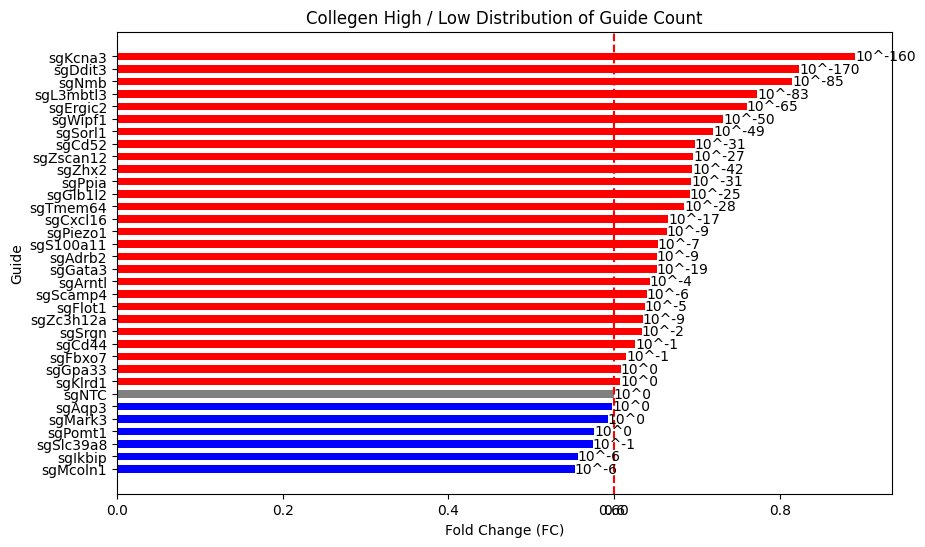

In [201]:
mean_df = count_df.groupby("collegen").mean().T
mean_df["FC"] = mean_df[1] / mean_df[0]
non_targeting_value = mean_df.loc['sgNTC', 'FC']

p_ = []
for guide in cdata.var_names:
    data = {
        'Group': [guide, guide, "NTC", "NTC"],
        'Category': ["high", "low", "high", "low"],
        'Sum': [sum_df.loc[guide].iloc[1], sum_df.loc[guide].iloc[0], sum_df.loc["sgNTC"].iloc[1], sum_df.loc["sgNTC"].iloc[0]]
    }
    # print(data['Sum'])
    c_table = pd.pivot_table(pd.DataFrame(data), values="Sum", index="Category", columns="Group", aggfunc=np.sum)
    chi2, p, dof, expected = chi2_contingency(c_table)
    p_.append(p)
    
mean_df["p"] = p_
mean_df = mean_df.sort_values(by='FC')

colors = ['blue' if fc < non_targeting_value else 'red' for fc in mean_df['FC']]
colors[mean_df.index.get_loc('sgNTC')] = 'grey'

plt.figure(figsize=(10, 6))
bars = plt.barh(y=mean_df.index, width=mean_df['FC'], color=colors, height=0.6)

plt.axvline(x=non_targeting_value, color='r', linestyle='--')

y_max = mean_df.max()[0]
step = 0.1
for i, p in enumerate(mean_df["p"]):
    x = i
    y = max(mean_df["FC"].iloc[i], mean_df["FC"].iloc[i])
    plt.text(y, x, f"10^{int(np.log10(p))}", ha='left', va='center', color='k')

plt.xlabel('Fold Change (FC)')
plt.ylabel('Guide')
plt.title('Collegen High / Low Distribution of Guide Count')

plt.text(mean_df.loc["sgNTC", "FC"], -3.9, f"{mean_df.loc["sgNTC", "FC"]:.2f}", ha='center', va='bottom', color='k')

plt.show()

In [ ]:
sc.tl.rank_genes_groups(cdata, group_by:)

In [23]:
theshold = 17
mask_dict = {}
for guide in cdata.var_names:
    mask_dict[guide] = np.array((cdata[:, guide].X > 0)).reshape(1, -1)[0]

In [24]:
c_df = {}
for guide in cdata.var_names:
    c_vec = cdata[mask_dict[guide]].obs["collegen"].value_counts()
    c_df[guide] = c_vec.tolist()
c_df = pd.DataFrame(c_df).T
c_df.columns = ["low", "high"]

KeyError: 'collegen'

In [444]:
p_ = []
for guide in cdata.var_names:
    data = {
        'Group': [guide, guide, "NTC", "NTC"],
        'Category': ["high", "low", "high", "low"],
        'Sum': [c_df.loc[guide].iloc[1], c_df.loc[guide].iloc[0], c_df.loc["sgnon-targeting"].iloc[1], c_df.loc["sgnon-targeting"].iloc[0]]
    }
    # print(data['Sum'])
    c_table = pd.pivot_table(pd.DataFrame(data), values="Sum", index="Category", columns="Group", aggfunc=np.sum)
    chi2, p, dof, expected = chi2_contingency(c_table)
    p_.append(p)

/tmp/ipykernel_66039/606298067.py:9: FutureWarning: The provided callable <function sum at 0x7fb8243028e0> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.
  c_table = pd.pivot_table(pd.DataFrame(data), values="Sum", index="Category", columns="Group", aggfunc=np.sum)
/tmp/ipykernel_66039/606298067.py:9: FutureWarning: The provided callable <function sum at 0x7fb8243028e0> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.
  c_table = pd.pivot_table(pd.DataFrame(data), values="Sum", index="Category", columns="Group", aggfunc=np.sum)
/tmp/ipykernel_66039/606298067.py:9: FutureWarning: The provided callable <function sum at 0x7fb8243028e0> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used di

In [21]:
c_df

NameError: name 'c_df' is not defined

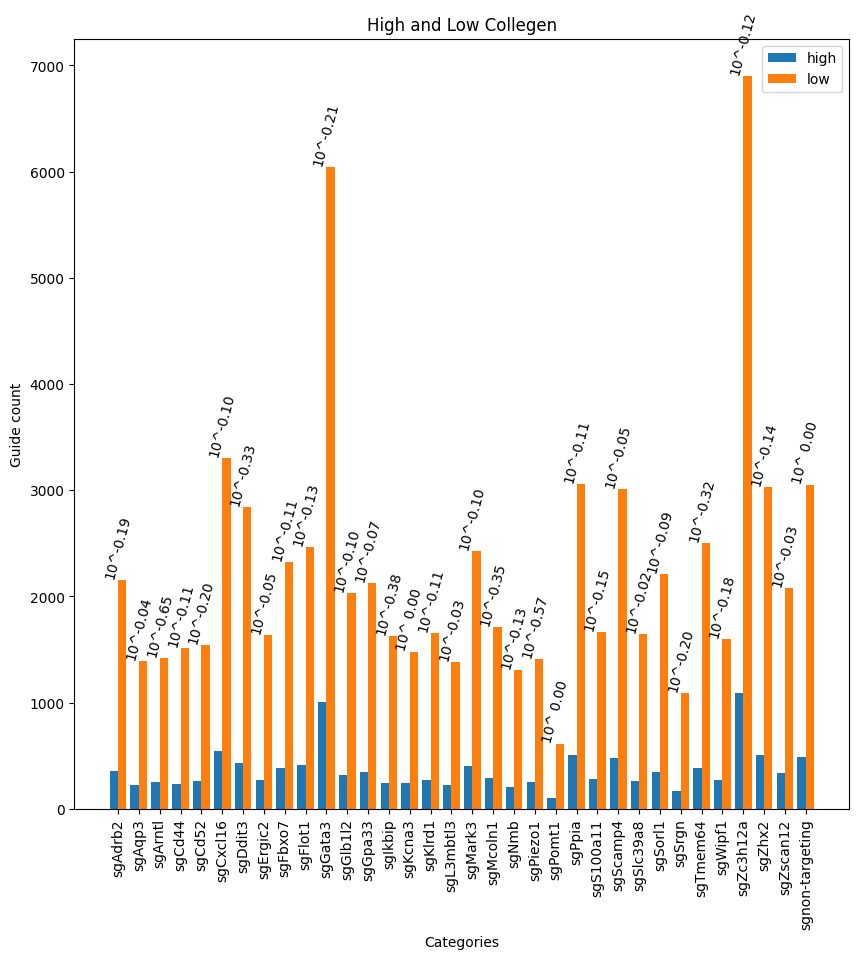

In [456]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
bar_width = 0.4
indices = np.arange(len(c_df.index))

ax.bar(indices - bar_width/2, c_df["high"], width=bar_width, label="high")
ax.bar(indices + bar_width/2, c_df["low"], width=bar_width, label="low")

ax.set_xlabel('Categories')
ax.set_ylabel('Guide count')
ax.set_title('High and Low Collegen')
ax.set_xticks(indices)
ax.set_xticklabels(mean_df.index)

y_max = mean_df.max()[0]
step = 0.1
for i, p in enumerate(p_):
    x = i
    y = max(c_df.iloc[i, 0], c_df.iloc[i, 1])
    plt.text(x, y, f"10^{np.log10(p): .2f}", ha='center', va='bottom', color='k', rotation=75)

plt.xticks(rotation=90)
ax.legend()
plt.show()

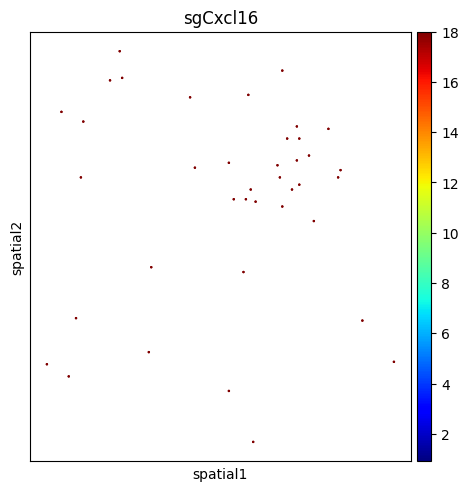

In [13]:
sq.pl.spatial_scatter(cdata[cdata[:, "sgCxcl16"].X > 17], color="sgCxcl16", shape=None, size=2, library_id="spatial", vmax=1, cmap="jet")

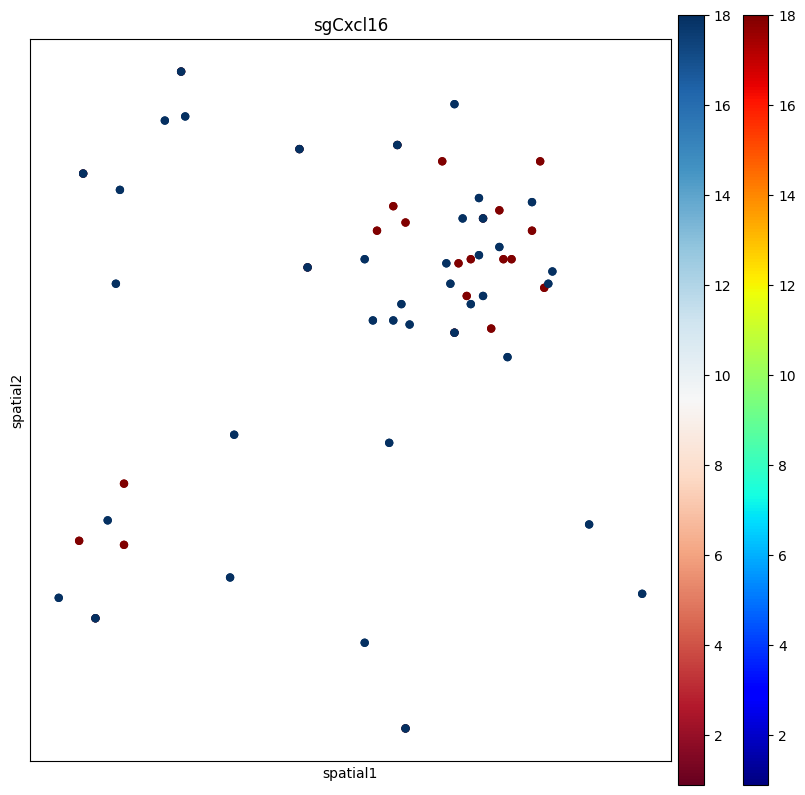

In [20]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
sq.pl.spatial_scatter(cdata[cdata[:, "sgnon-targeting"].X > 17], color="sgnon-targeting", shape=None, size=100, library_id="spatial", vmax=1, cmap="jet", ax=ax)
sq.pl.spatial_scatter(cdata[cdata[:, "sgCxcl16"].X > 17], color="sgCxcl16", shape=None, size=100, library_id="spatial", vmax=1, cmap="RdBu", ax=ax)
plt.gca().invert_yaxis()

# Without Bounderies

In [474]:
w = weights.DistanceBand.from_array(fdata.obsm["spatial"], threshold=250)

In [475]:
mat = w.full()[0]

In [476]:
def cal_l(idx):
    connected = fdata[mat[idx] > 0]
    N = len(connected)
    a = np.sum(connected.obs["collegen"])
    if N < 7: return 0
    return a / N * (N - a) / N

In [477]:
l_df = fdata.obs

In [478]:
l_df["idx"] = range(len(l_df.index))

In [479]:
l_df["idx"]

10265        0
6487         1
6848         2
5049         3
6490         4
         ...  
2704     23083
3963     23084
48       23085
3603     23086
4143     23087
Name: idx, Length: 23088, dtype: int64

In [480]:
fdata

AnnData object with n_obs × n_vars = 23088 × 27889
    obs: 'idx'
    obsm: 'spatial'

In [486]:
l_df["L"] = l_df["idx"].map(cal_l)

In [487]:
fdata.obs = l_df

In [526]:
np.unique(fdata.obs["L"])

array([0.        , 0.0475    , 0.0498615 , 0.05246914, 0.05536332,
       0.05859375, 0.06222222, 0.06632653, 0.07100592, 0.07638889,
       0.08264463, 0.09      , 0.09418283, 0.09876543, 0.10380623,
       0.109375  , 0.11555556, 0.12244898, 0.1275    , 0.13017751,
       0.13296399, 0.13888889, 0.13888889, 0.14532872, 0.14876033,
       0.15234375, 0.16      , 0.16      , 0.16620499, 0.16836735,
       0.17283951, 0.17751479, 0.1799308 , 0.1875    , 0.19390582,
       0.19555556, 0.19834711, 0.20061728, 0.20408163, 0.20761246,
       0.21      , 0.21      , 0.21301775, 0.21484375, 0.21606648,
       0.22222222, 0.2275    , 0.2283737 , 0.22959184, 0.23140496,
       0.23268698, 0.234375  , 0.23668639, 0.23765432, 0.23765432,
       0.24      , 0.24      , 0.24      , 0.24      , 0.24221453,
       0.24221453, 0.24305556, 0.24376731, 0.24489796, 0.24609375,
       0.24691358, 0.2475    , 0.24793388, 0.24852071, 0.24888889,
       0.24913495, 0.24930748, 0.25      ])

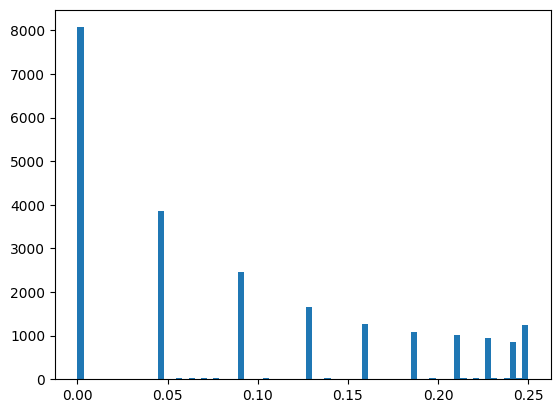

In [489]:
plt.hist(fdata.obs["L"], bins=len(np.unique(fdata.obs["L"])))
plt.show()

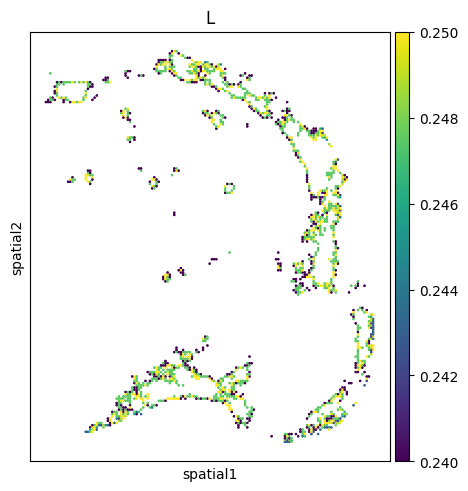

In [527]:
sq.pl.spatial_scatter(fdata[fdata.obs["L"] > 0.24], color="L", shape=None, size=2, library_id="spatial")

In [520]:
fdata[fdata.obs["L"] > 0.24]

View of AnnData object with n_obs × n_vars = 3143 × 27889
    obs: 'idx', 'collegen_score', 'collegen', 'L'
    obsm: 'spatial'

In [532]:
count_df = pd.DataFrame(cdata.X)
count_df.columns = cdata.var_names
count_df["L"] = np.array(fdata.obs["L"] > 0.24) & np.array(fdata.obs["collegen"] == 0)
sum_df = count_df.groupby("L").sum().T
mean_df = count_df.groupby("L").mean().T

In [533]:
mean_df

L,False,True
sgAdrb2,0.318786,0.190776
sgAqp3,0.191154,0.095388
sgArntl,0.188262,0.093291
sgCd44,0.221334,0.141509
sgCd52,0.208141,0.150943
sgCxcl16,0.526114,0.302935
sgDdit3,0.388497,0.258910
sgErgic2,0.209858,0.312369
sgFbxo7,0.314900,0.171908
sgFlot1,0.339613,0.259958


/tmp/ipykernel_66039/1639558156.py:11: FutureWarning: The provided callable <function sum at 0x7fb8243028e0> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.
  c_table = pd.pivot_table(pd.DataFrame(data), values="Sum", index="Category", columns="Group", aggfunc=np.sum)
/tmp/ipykernel_66039/1639558156.py:11: FutureWarning: The provided callable <function sum at 0x7fb8243028e0> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.
  c_table = pd.pivot_table(pd.DataFrame(data), values="Sum", index="Category", columns="Group", aggfunc=np.sum)
/tmp/ipykernel_66039/1639558156.py:11: FutureWarning: The provided callable <function sum at 0x7fb8243028e0> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be u

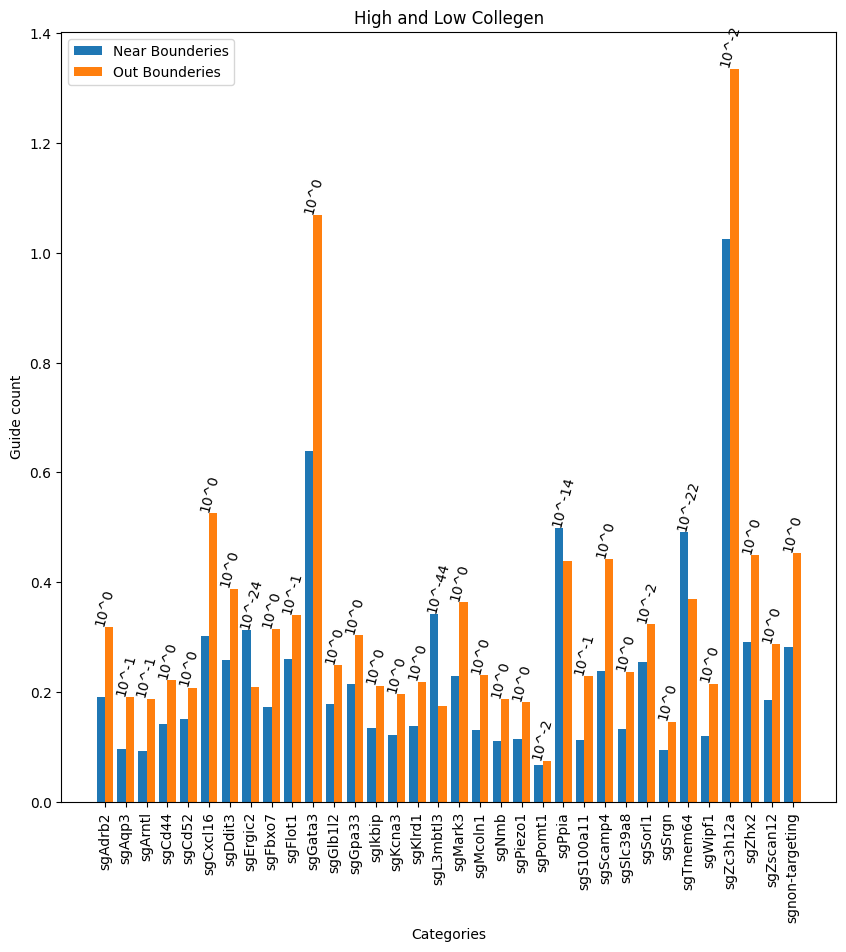

In [534]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10))

p_ = []
for guide in cdata.var_names:
    data = {
        'Group': [guide, guide, "NTC", "NTC"],
        'Category': ["high", "low", "high", "low"],
        'Sum': [sum_df.loc[guide].iloc[1], sum_df.loc[guide].iloc[0], sum_df.loc["sgnon-targeting"].iloc[1], sum_df.loc["sgnon-targeting"].iloc[0]]
    }
    # print(data['Sum'])
    c_table = pd.pivot_table(pd.DataFrame(data), values="Sum", index="Category", columns="Group", aggfunc=np.sum)
    chi2, p, dof, expected = chi2_contingency(c_table)
    p_.append(p)

bar_width = 0.4
indices = np.arange(len(mean_df.index))

ax.bar(indices - bar_width/2, mean_df[True], width=bar_width, label="Near Bounderies")
ax.bar(indices + bar_width/2, mean_df[False], width=bar_width, label="Out Bounderies")

ax.set_xlabel('Categories')
ax.set_ylabel('Guide count')
ax.set_title('High and Low Collegen')
ax.set_xticks(indices)
ax.set_xticklabels(mean_df.index)

y_max = mean_df.max()[0]
step = 0.1
for i, p in enumerate(p_):
    x = i
    y = max(mean_df.iloc[i, 0], mean_df.iloc[i, 1])
    plt.text(x, y, f"10^{int(np.log10(p))}", ha='center', va='bottom', color='k', rotation=75)

plt.xticks(rotation=90)
ax.legend()
plt.show()

In [124]:
fdata.obs["L"] = fdata.obs["L"] > 0.23

In [ ]:
fdata[fdata.obs["L"]]

In [134]:
bound_data = extract_bin20(fdata_bin20, fdata[fdata.obs["L"]])

In [35]:
fdata[:4].obs["L"]

10265    0.0
6487     0.0
6848     0.0
5049     0.0
Name: L, dtype: float64

In [232]:
fdata.obs["L"] = pd.DataFrame(range(0, len(fdata.obs_names))).astype(int).map(lambda x: np.where(w.full()[0][x])[0])

KeyboardInterrupt: 

In [231]:
fdata.obs.index

Index(['10265', '6487', '6848', '5049', '6490', '17116', '3081', '4882',
       '9924', '7945',
       ...
       '194', '4323', '1806', '2886', '3243', '2704', '3963', '48', '3603',
       '4143'],
      dtype='object', length=23088)

# Distance to low

In [23]:
def cal_min_distance_to_border(adata, bin):
    bin_coords = bin.obsm["spatial"][0]

    low_region_coords = adata[adata.obs["collegen"] == 'low'].obsm["spatial"]
    distances = np.sqrt(np.sum((low_region_coords - bin_coords) ** 2, axis=1))

    return np.min(distances)

In [30]:
threshold = 17
mask = cdata[:, "sgGata3"].X > threshold

In [116]:
np.min([np.sqrt((array[0] - bin_coords[0]) ** 2 + (array[1] - bin_coords[1]) ** 2) for array in low_region_coords.toarray()])

10932.82218825496

In [123]:
fdata[fdata.obs["collegen"] > 0]

View of AnnData object with n_obs × n_vars = 7367 × 27889
    obs: 'spatial_cov', 'collegen_score', 'collegen'
    obsm: 'spatial'

In [125]:
bin_coords = fdata[mask][0].obsm["spatial"][0]

low_region_coords = fdata[fdata.obs["collegen"] > 0].obsm["spatial"]
#distances = map(lambda , low_region_coords.toarray())
distances = np.sqrt(np.sum((low_region_coords - bin_coords) ** 2, axis=1))

np.min(distances)

99.0

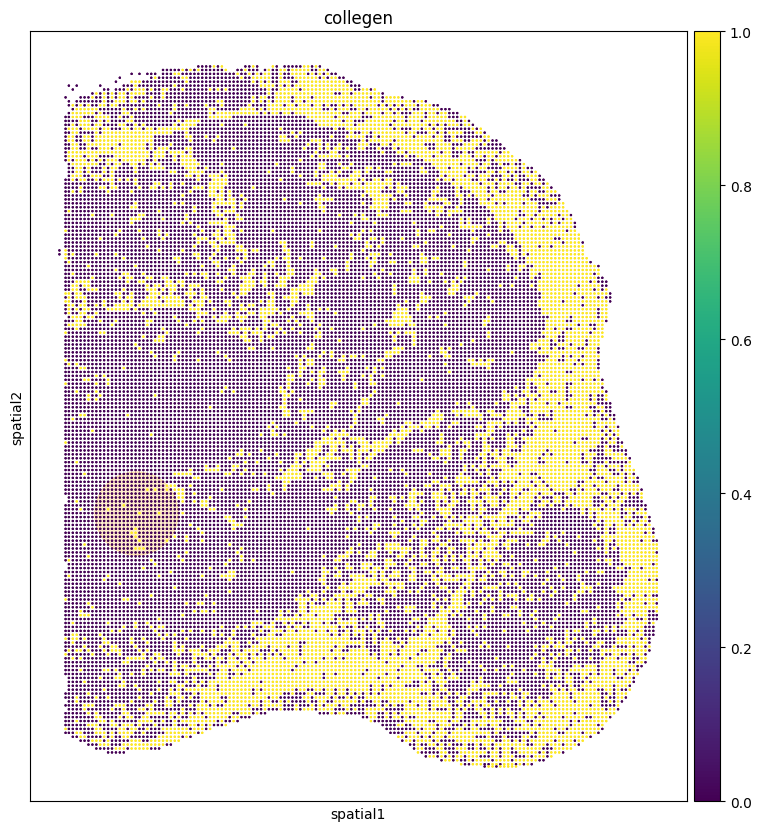

In [121]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
plot_dot(cdata[mask][0], gene_name="sgGata3", ax=ax)
sq.pl.spatial_scatter(fdata, color="collegen", shape=None, size=2, library_id="spatial", ax=ax)

In [29]:
cdata.X

array([[0, 0, 0, ..., 0, 0, 0],
       [1, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 1, 0, 0]])

In [31]:
dist_dict = {}
low_region_coords = fdata[fdata.obs["collegen"] == 0].obsm["spatial"]
for guide in cdata.var_names:
    dist_dict[guide] = []
    mask = np.array(cdata[:, guide].X > threshold).T & np.array(fdata.obs["collegen"] > 0).T
    for i in tqdm(range(np.sum(mask))):
        dist_dict[guide].append(cal_min_dist(fdata, cdata[mask][i], low_region_coords))

100%|██████████| 2/2 [00:00<00:00, 686.58it/s]
0it [00:00, ?it/s]
100%|██████████| 3/3 [00:00<00:00, 573.67it/s]
0it [00:00, ?it/s]
100%|██████████| 7/7 [00:00<00:00, 766.66it/s]
0it [00:00, ?it/s]
100%|██████████| 5/5 [00:00<00:00, 331.10it/s]


In [32]:
def cal_min_dist(fdata, dest_bin, low_region_coords):
    bin_coords = dest_bin.obsm["spatial"][0]
    distances = np.sqrt(np.sum((low_region_coords - bin_coords) ** 2, axis=1))
    return(np.min(distances))

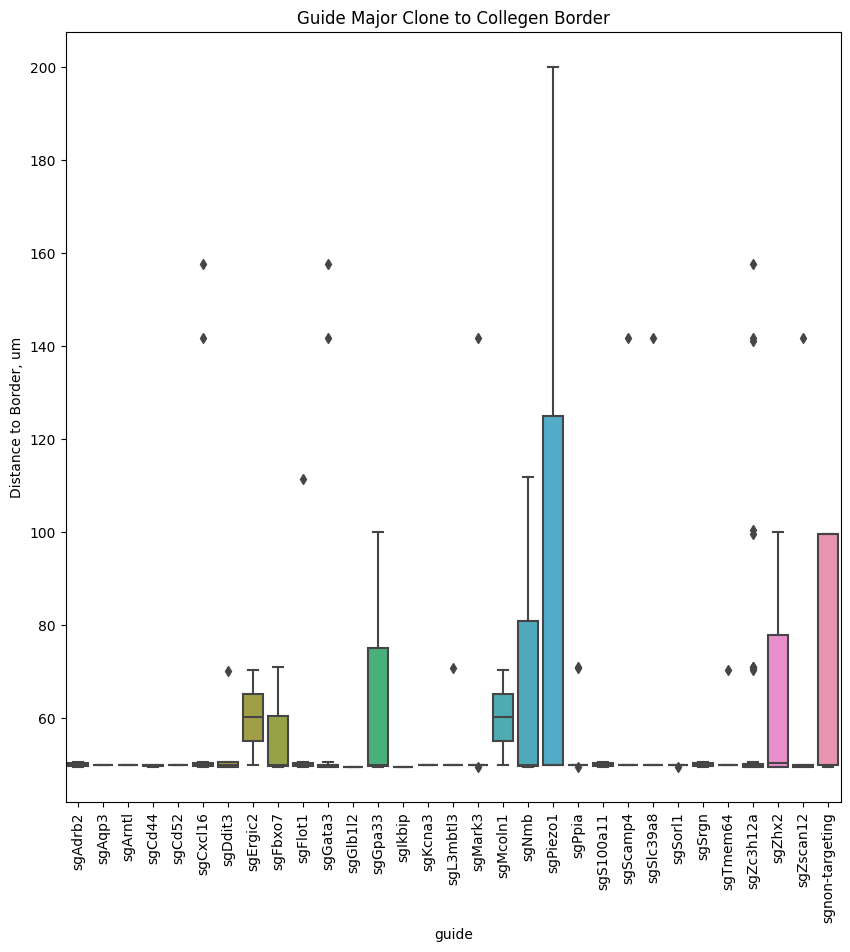

In [34]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
long_format_data = pd.DataFrame([(k, v) for k, lst in dist_dict.items() for v in lst], columns=['guide', 'value'])
long_format_data['value'] = long_format_data['value'] / 2
sns.boxplot(x='guide', y='value', data=long_format_data, ax=ax)
plt.ylabel("Distance to Border, um")
plt.title("Guide Major Clone to Collegen Border")
plt.xticks(rotation=90)
plt.show()

# distance in bin20

In [35]:
sc.tl.score_genes(fdata_bin20, gene_list=["Col1a1", "Col1a2"], score_name="collegen_score")

In [36]:
fdata_bin20.obs["collegen"] = fdata_bin20.obs["collegen_score"] > 

In [47]:
fdata_bin20.obs["collegen"] = fdata_bin20[:, ["Col1a1", "Col1a2"]].X.sum(axis=1) > 0

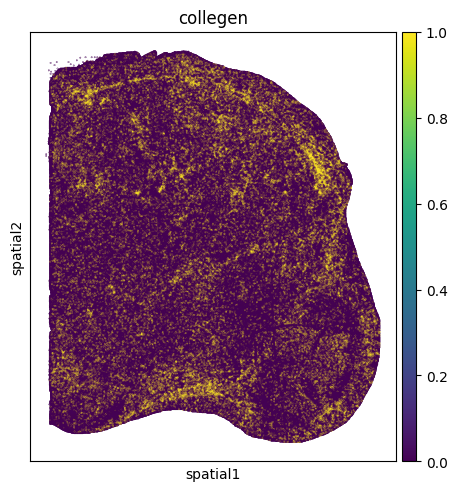

In [48]:
sq.pl.spatial_scatter(fdata_bin20, color="collegen", shape=None, size=0.1, library_id="spatial", cmap="viridis")

In [39]:
np.quantile(cdata_bin20.X, 0.999)

3.0

In [40]:
dist_dict = {}
low_region_coords = fdata_bin20[fdata_bin20.obs["collegen"] == 0].obsm["spatial"]
for guide in cdata.var_names:
    dist_dict[guide] = []
    mask = np.array(cdata_bin20[:, guide].X > 3).T & np.array(fdata_bin20.obs["collegen"] > 0).T
    for i in tqdm(range(np.sum(mask))):
        dist_dict[guide].append(cal_min_dist(fdata_bin20, cdata_bin20[mask][i], low_region_coords))

100%|██████████| 148/148 [00:01<00:00, 96.39it/s]


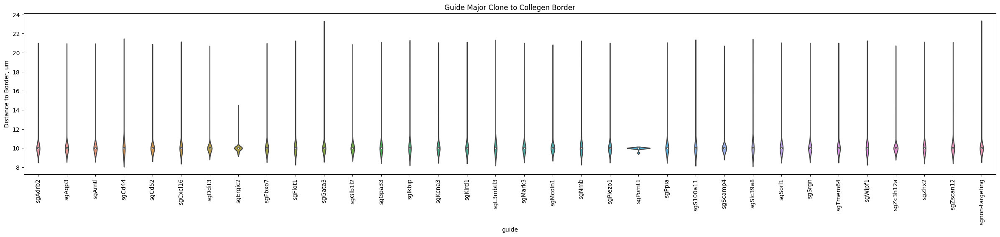

In [44]:
fig, ax = plt.subplots(1, 1, figsize=(30, 5))
long_format_data = pd.DataFrame([(k, v) for k, lst in dist_dict.items() for v in lst], columns=['guide', 'value'])
long_format_data['value'] = long_format_data['value'] / 2
sns.violinplot(x='guide', y='value', data=long_format_data, ax=ax)
plt.ylabel("Distance to Border, um")
plt.title("Guide Major Clone to Collegen Border")
plt.xticks(rotation=90)
plt.show()

In [61]:
long_format_data[long_format_data.value > 10].groupby("guide").mean().values.T

array([[17.07106781, 17.07106781, 17.07106781, 16.82842712, 17.07106781,
        17.07106781, 17.07106781, 14.14213562, 18.04737854, 17.65685425,
        16.36651765, 17.07106781, 17.07106781, 18.04737854, 16.09475708,
        17.07106781, 17.07106781, 17.07106781, 20.        , 20.        ,
        20.        , 16.65264893, 16.48528137, 16.09475708, 16.46404521,
        15.75685425, 20.        , 16.48528137, 18.04737854, 14.99103788,
        16.09475708, 16.48528137, 18.8342718 ]])

[]

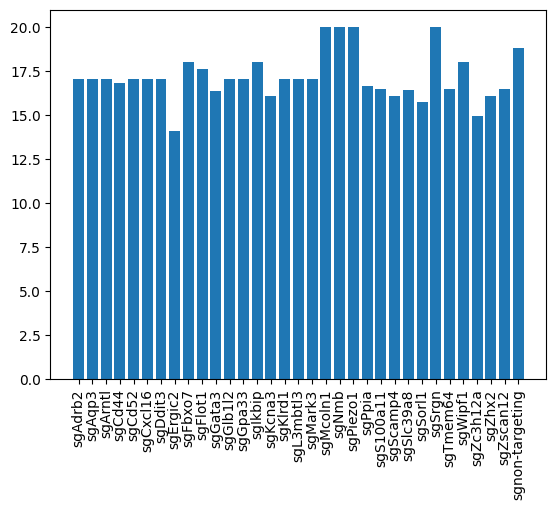

In [65]:
plt.bar(cdata.var_names[cdata.var_names != "sgPomt1"], long_format_data[long_format_data.value > 10].groupby("guide").mean().values.T[0])
plt.xticks(rotation=90)
plt.plot()

# PDAC markers

In [7]:
fdata.X.toarray().sum()

138218921.61686125

In [9]:
fdata.layers["counts"].toarray().sum()

415723481

In [18]:
fdata.var_names[fdata.var_names.str.startswith("Nid")]

Index(['Nid1', 'Nid2'], dtype='object')

In [19]:
gene_list = ["Col4a2", "Col4a1", "Lama2", "Lama3", "Lama5", "Lamb2", "Lamc1", "Lamb3", "Lamb1", "Lamc2", "Nid1"]

/tmp/ipykernel_76974/588517075.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(20, 20))


<Figure size 2000x2000 with 0 Axes>

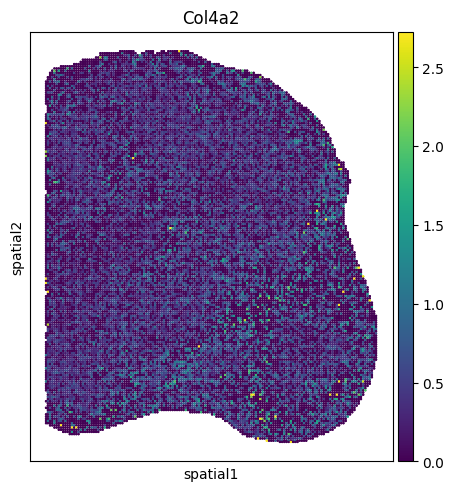

<Figure size 2000x2000 with 0 Axes>

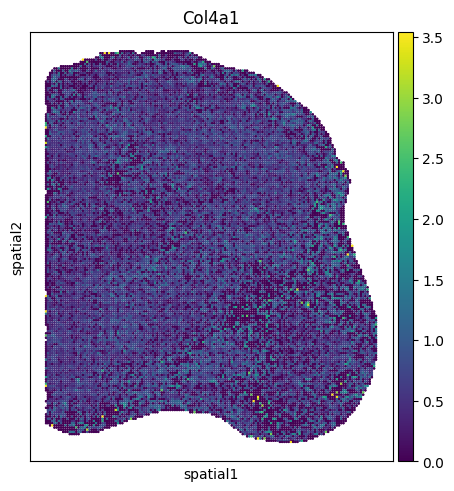

<Figure size 2000x2000 with 0 Axes>

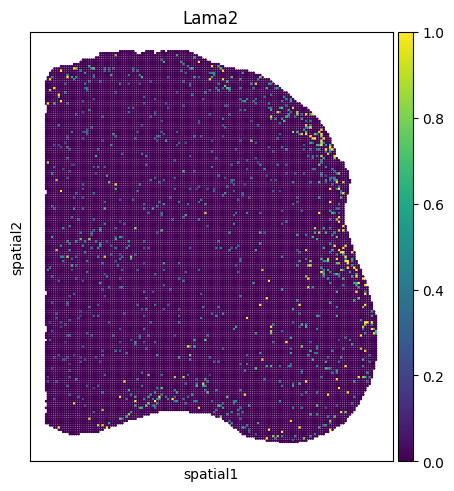

<Figure size 2000x2000 with 0 Axes>

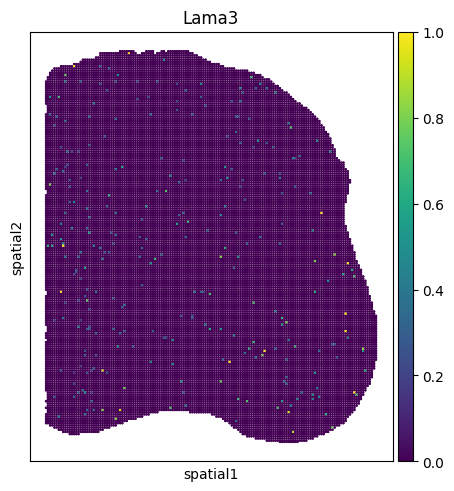

<Figure size 2000x2000 with 0 Axes>

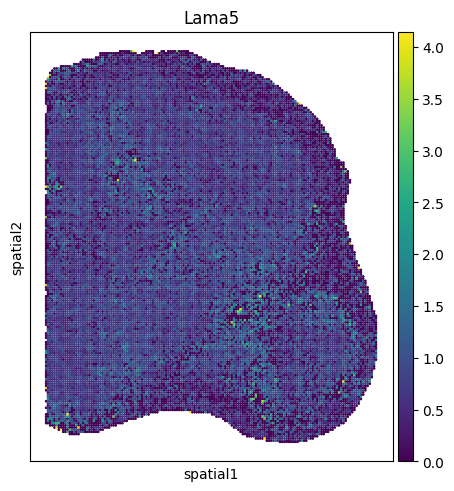

<Figure size 2000x2000 with 0 Axes>

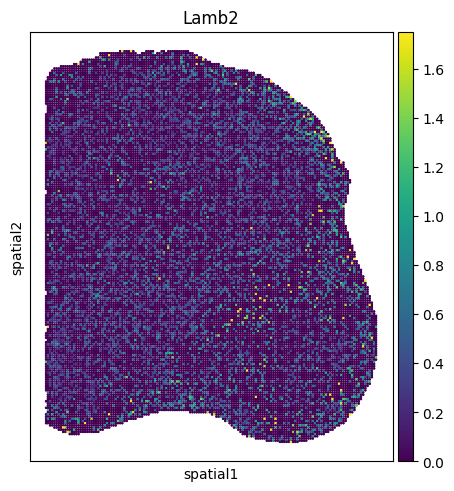

<Figure size 2000x2000 with 0 Axes>

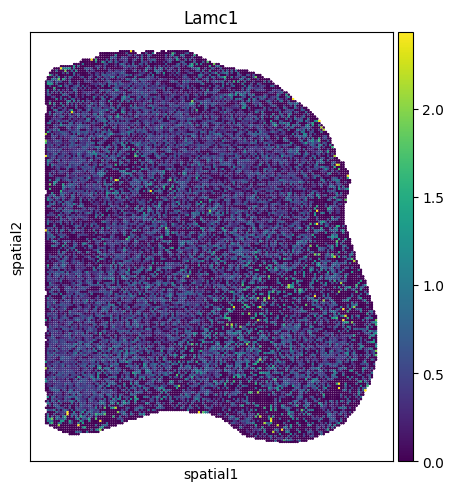

<Figure size 2000x2000 with 0 Axes>

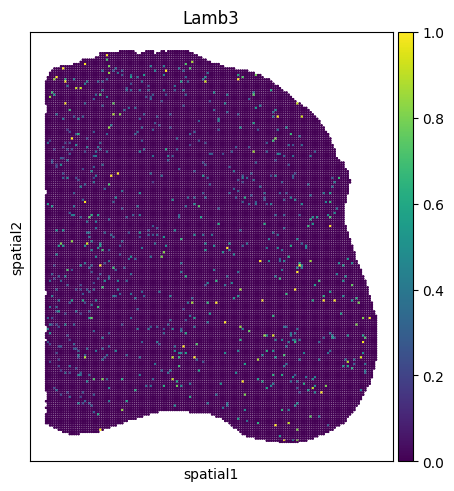

<Figure size 2000x2000 with 0 Axes>

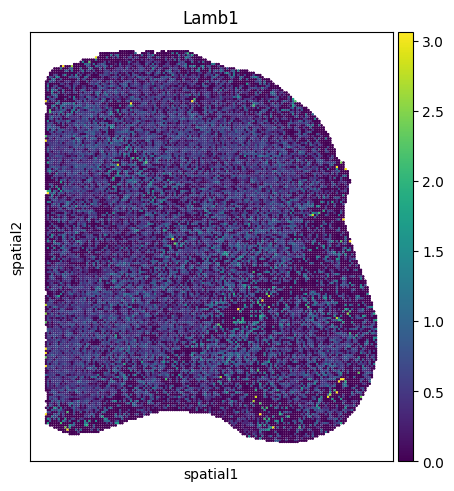

<Figure size 2000x2000 with 0 Axes>

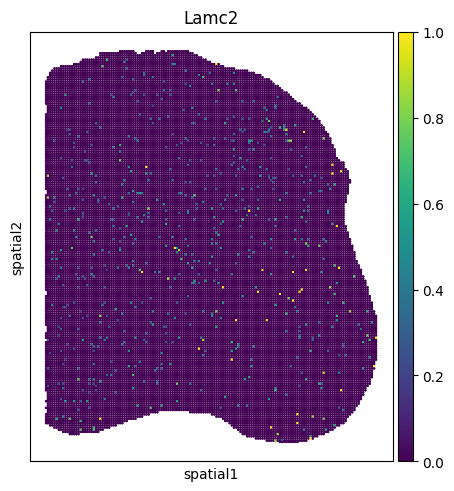

<Figure size 2000x2000 with 0 Axes>

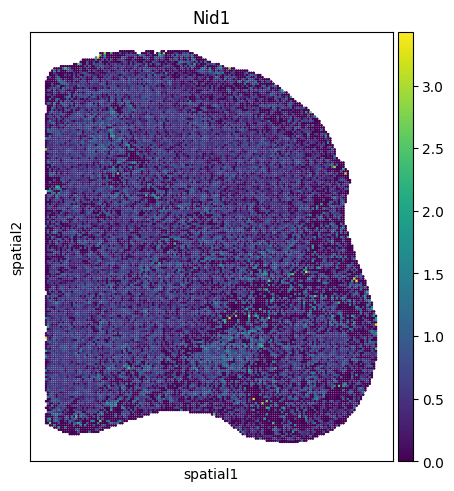

In [36]:
for gene in gene_list:
    plt.figure(figsize=(20, 20))
    sq.pl.spatial_scatter(fdata[(fdata.obs["marker"] == '2-1')],
        library_key="marker",
        shape=None,
        size=2,
        color=gene,
        vmax=np.max([np.quantile(fdata[:, gene].X.toarray(), 0.99), 1]),
        vmin=0)

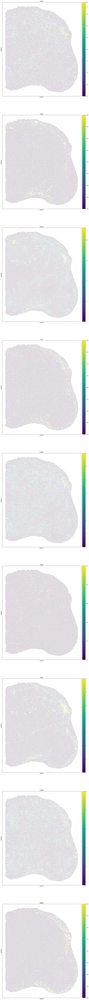

In [45]:
fig, axs = plt.subplots(len(gene_list), 2, figsize=(10, len(gene_list) * 10))
for idx, gene in enumerate(gene_list):
    ax = axs[idx]
    sq.pl.spatial_scatter(fdata[(fdata.obs["marker"] == '2-1')],
        library_key="marker",
        shape=None,
        size=2,
        color=gene,
        layer="counts",
        vmax=np.max([np.quantile(fdata[:, gene].layers["counts"].toarray(), 0.99), 1]),
        vmin=0,
        ax=ax)

In [40]:
gene_list = ["Acta2", "Sfrp2", "Col1a1", "Lum", "Col5a1", "Inhba", "Postn", "Col6a3", "Igfbp5"]

<Figure size 2000x2000 with 0 Axes>

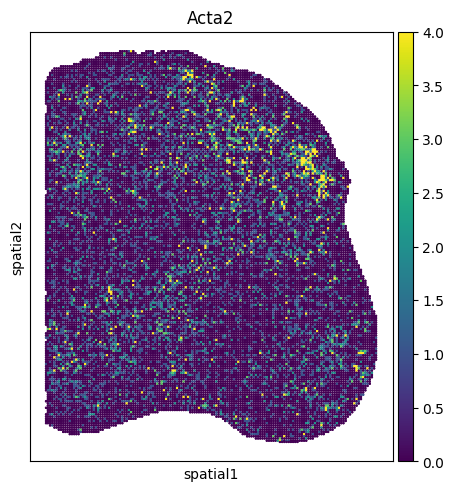

<Figure size 2000x2000 with 0 Axes>

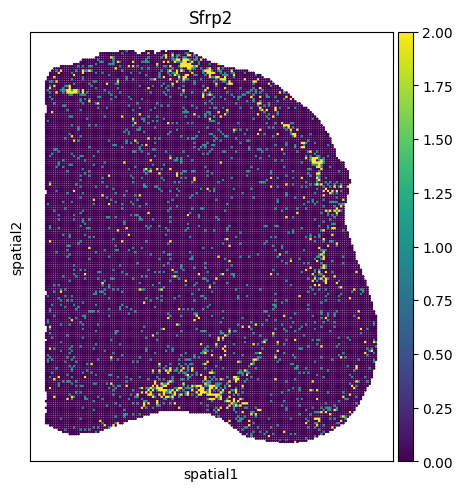

<Figure size 2000x2000 with 0 Axes>

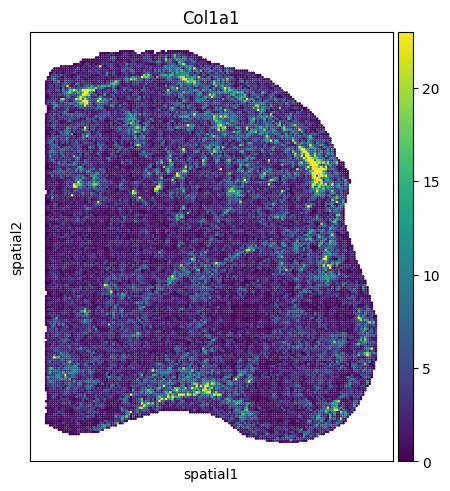

<Figure size 2000x2000 with 0 Axes>

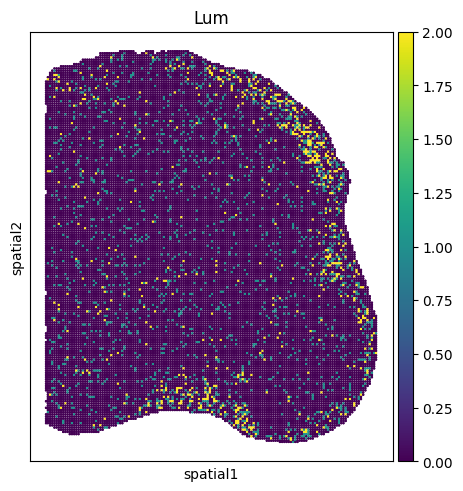

<Figure size 2000x2000 with 0 Axes>

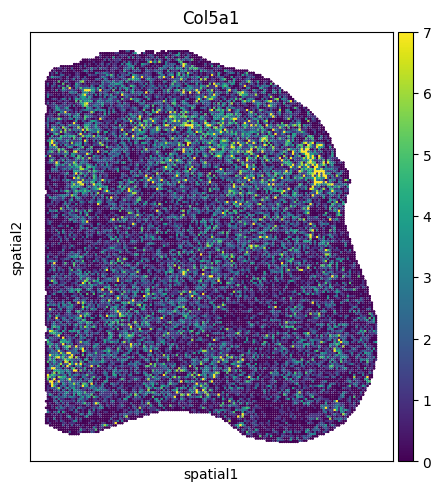

<Figure size 2000x2000 with 0 Axes>

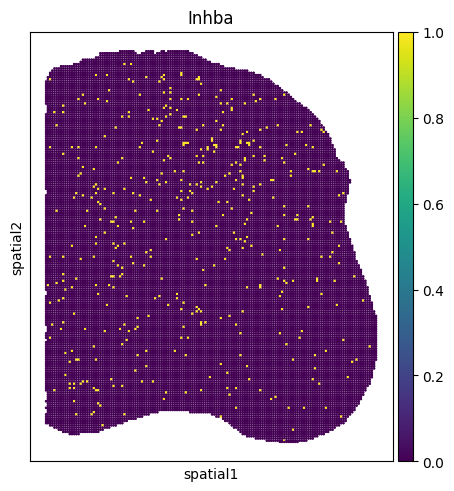

<Figure size 2000x2000 with 0 Axes>

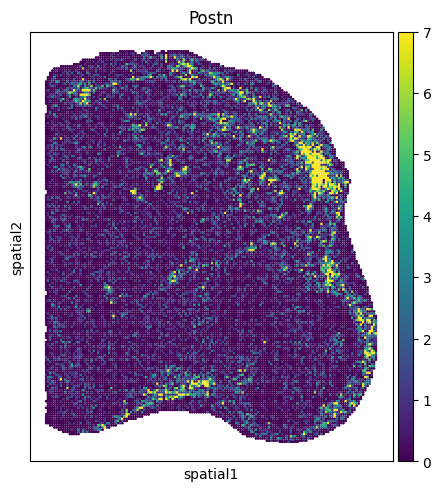

<Figure size 2000x2000 with 0 Axes>

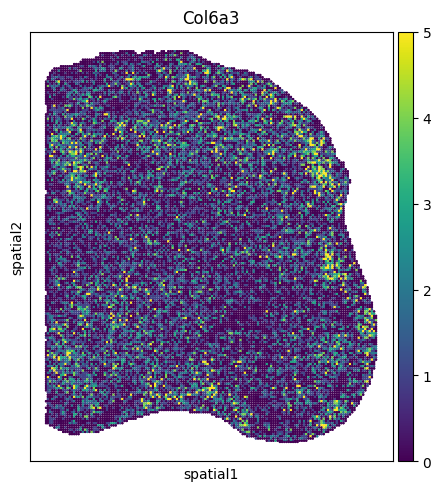

<Figure size 2000x2000 with 0 Axes>

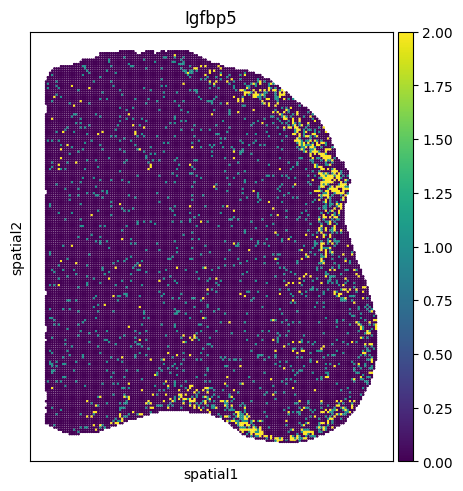

In [41]:
for gene in gene_list:
    plt.figure(figsize=(20, 20))
    sq.pl.spatial_scatter(fdata[(fdata.obs["marker"] == '2-1')],
        library_key="marker",
        shape=None,
        size=2,
        color=gene,
        layer="counts",
        vmax=np.max([np.quantile(fdata[:, gene].layers["counts"].toarray(), 0.99), 1]),
        vmin=0)

<Figure size 2000x2000 with 0 Axes>

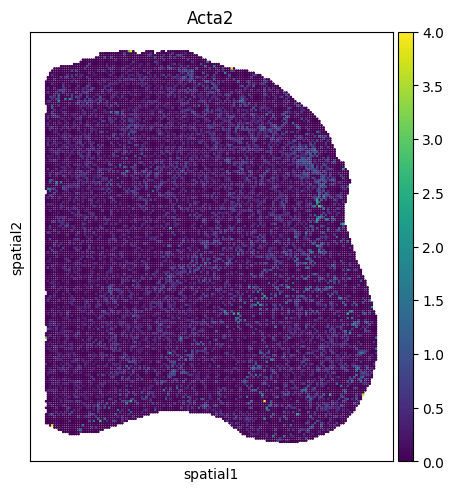

<Figure size 2000x2000 with 0 Axes>

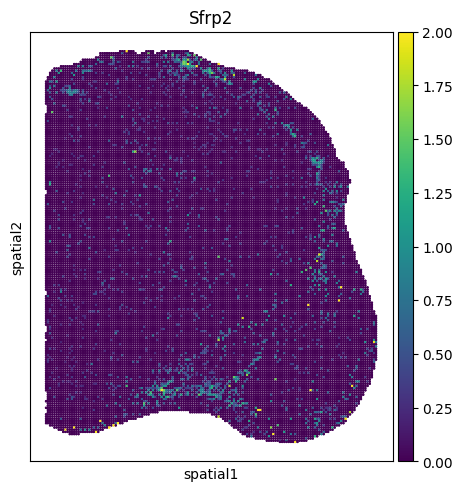

<Figure size 2000x2000 with 0 Axes>

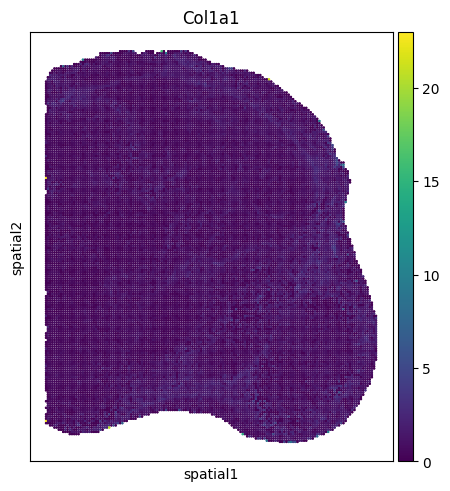

<Figure size 2000x2000 with 0 Axes>

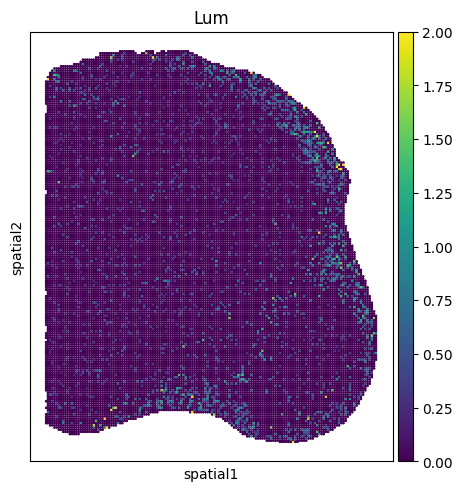

<Figure size 2000x2000 with 0 Axes>

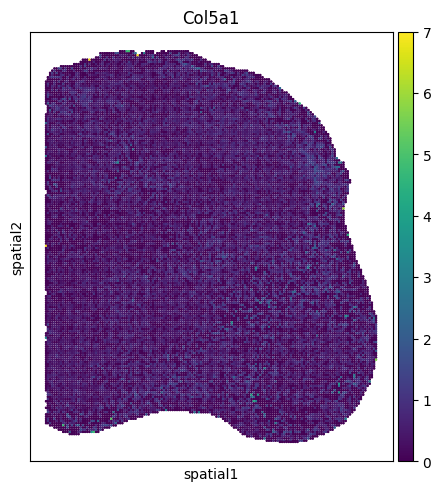

<Figure size 2000x2000 with 0 Axes>

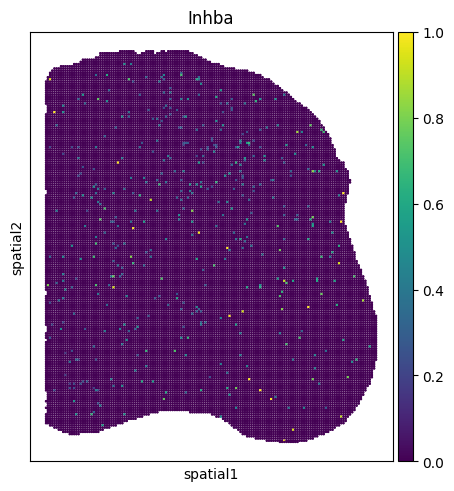

<Figure size 2000x2000 with 0 Axes>

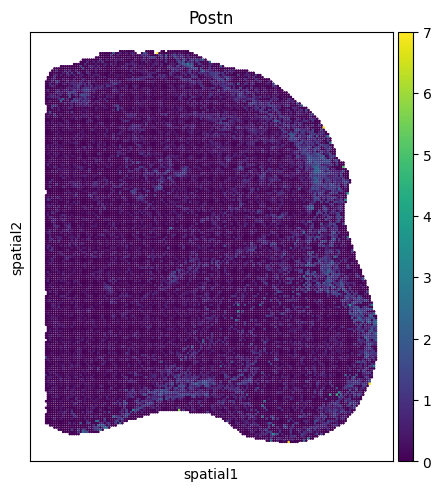

<Figure size 2000x2000 with 0 Axes>

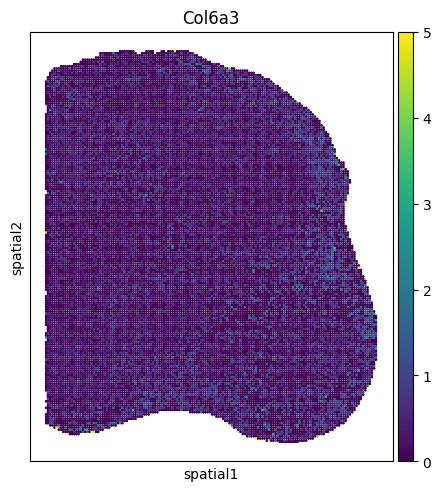

<Figure size 2000x2000 with 0 Axes>

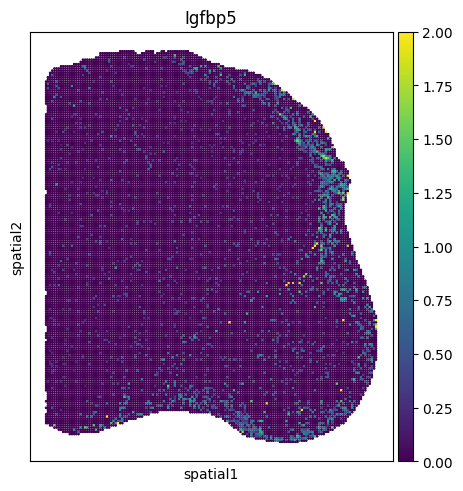

In [42]:
for gene in gene_list:
    plt.figure(figsize=(20, 20))
    sq.pl.spatial_scatter(fdata[(fdata.obs["marker"] == '2-1')],
        library_key="marker",
        shape=None,
        size=2,
        color=gene,
        vmax=np.max([np.quantile(fdata[:, gene].layers["counts"].toarray(), 0.99), 1]),
        vmin=0)